### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.

![](wgan_gp_3.png)

![](wgan_gp_1.png)

![](wgan_gp_2.png)

In [151]:
import torch
from torch import nn
from tqdm import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

## TRICK

### Iuput shape+grad

In [152]:
epsilon_shape=[256, 1, 1, 1]
epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()

### Get gradient

In [153]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

## TOOL

In [154]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

## GENERATOR+NOISE

In [155]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

## Critic

In [156]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## TRAINING

In [157]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

### Initialize

In [158]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

## Gradient Penalty

In [159]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

In [160]:
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    print('epsilon_shape:',epsilon_shape)
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    mixed_images = real * epsilon + fake * (1 - epsilon)
    print('mixed_images:', mixed_images.shape)
    mixed_scores = crit(mixed_images)
    print('mixed_scores:', mixed_scores.shape)
    
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
    
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

epsilon_shape: [256, 1, 1, 1]
mixed_images: torch.Size([256, 1, 28, 28])
mixed_scores: torch.Size([256, 1])
Success!


In [161]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    penalty = ((gradient_norm -1) **2).mean()
    return penalty

## Losses

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

In [162]:
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
   
    gen_loss = - crit_fake_pred.mean()
    return gen_loss

In [163]:
torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

tensor(True)

In [164]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp* c_lambda

    return crit_loss

In [165]:
torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

tensor(True)

 11%|█         | 50/469 [00:05<00:45,  9.28it/s]

Step 50: Generator loss: -0.1322198041062802, critic loss: 2.262276172578335


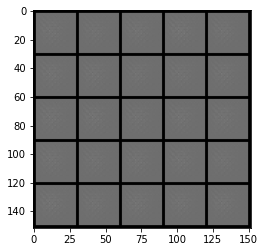

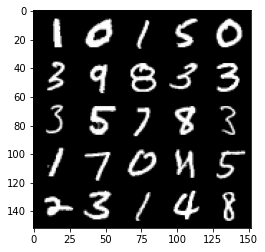

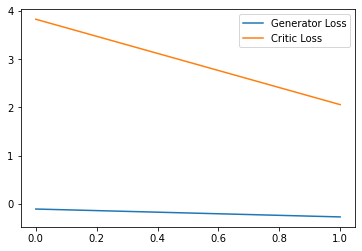

 21%|██▏       | 100/469 [00:11<00:39,  9.44it/s]

Step 100: Generator loss: 0.6671145207807422, critic loss: -1.378085681259632


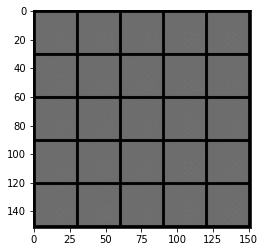

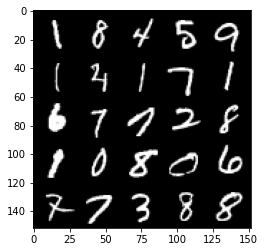

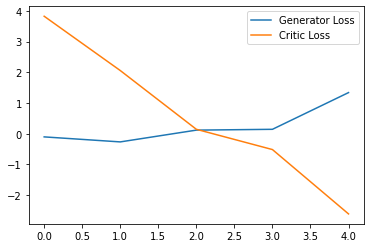

 32%|███▏      | 150/469 [00:17<00:33,  9.40it/s]

Step 150: Generator loss: 2.9379205536842345, critic loss: -9.173578693389892


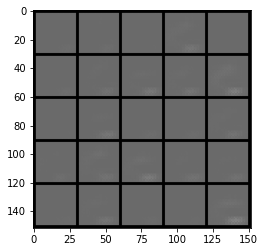

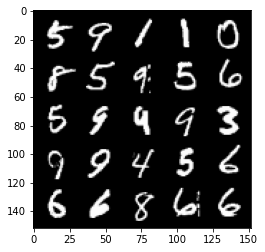

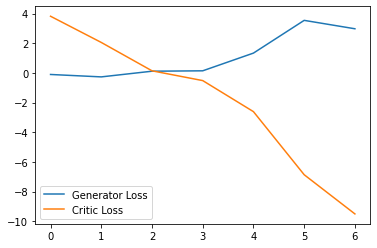

 43%|████▎     | 200/469 [00:23<00:29,  9.26it/s]

Step 200: Generator loss: 1.8036936011910438, critic loss: -25.90697921371459


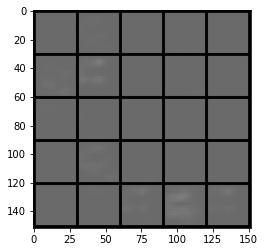

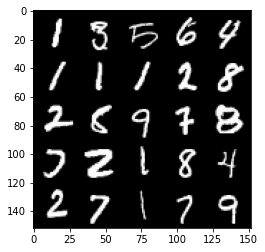

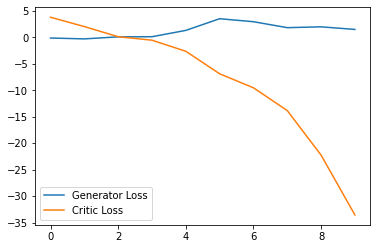

 53%|█████▎    | 250/469 [00:29<00:24,  9.11it/s]

Step 250: Generator loss: -2.3989990729093553, critic loss: -57.050302551269525


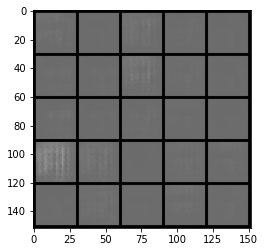

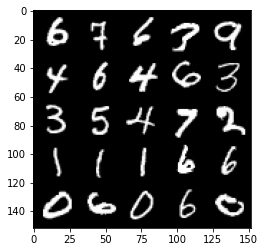

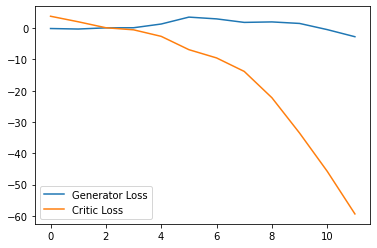

 64%|██████▍   | 300/469 [00:35<00:18,  9.08it/s]

Step 300: Generator loss: -3.773336787223816, critic loss: -100.61856901550287


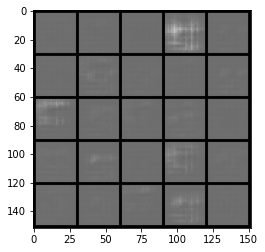

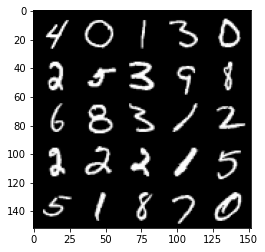

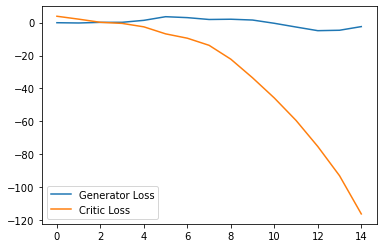

 75%|███████▍  | 350/469 [00:41<00:12,  9.59it/s]

Step 350: Generator loss: -1.6513921049237252, critic loss: -148.22419268798828


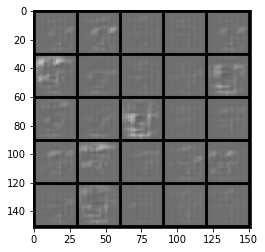

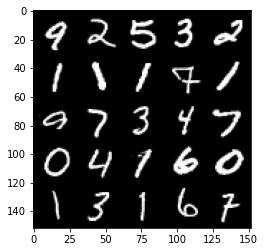

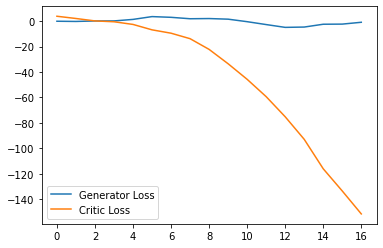

 85%|████████▌ | 400/469 [00:47<00:07,  9.58it/s]

Step 400: Generator loss: -2.307911155074835, critic loss: -205.98735910034185


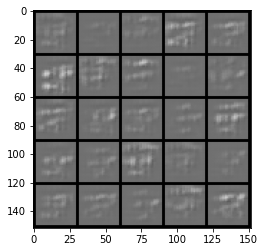

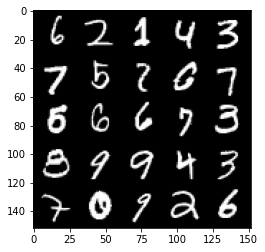

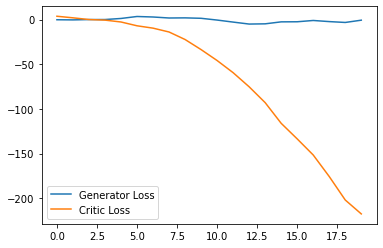

 96%|█████████▌| 450/469 [00:52<00:02,  9.45it/s]

Step 450: Generator loss: -14.75279993057251, critic loss: -202.69559753417968


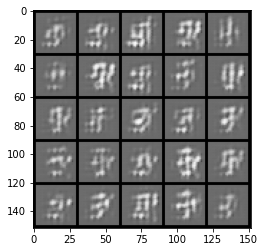

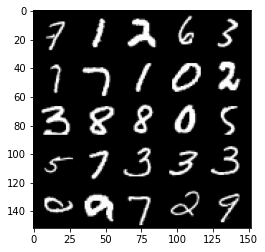

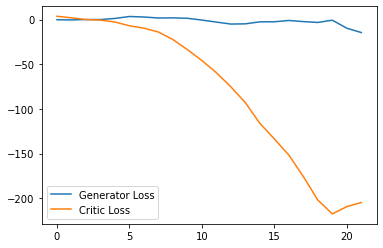

  7%|▋         | 31/469 [00:03<00:46,  9.44it/s]

Step 500: Generator loss: 5.96155356824398, critic loss: -261.90913212585457


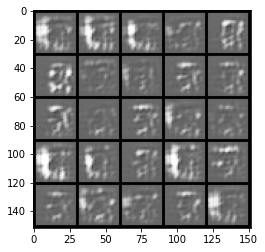

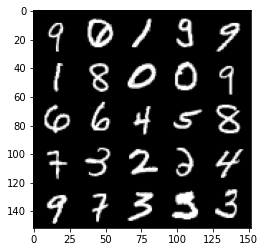

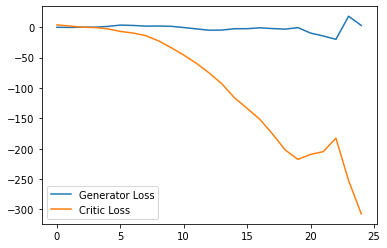

 17%|█▋        | 81/469 [00:09<00:41,  9.44it/s]

Step 550: Generator loss: -12.200461722314358, critic loss: -310.0092848815918


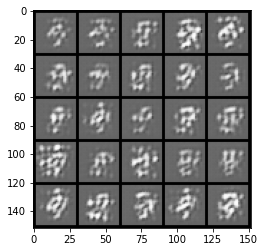

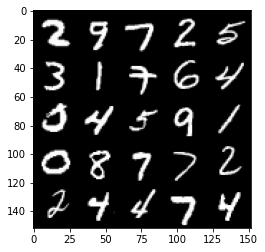

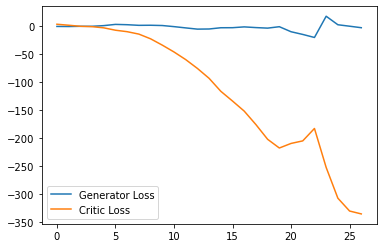

 28%|██▊       | 131/469 [00:15<00:35,  9.50it/s]

Step 600: Generator loss: -4.2155259555578235, critic loss: -253.1933052978516


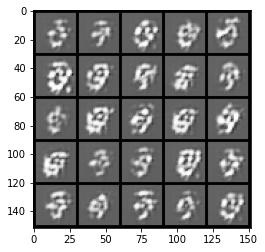

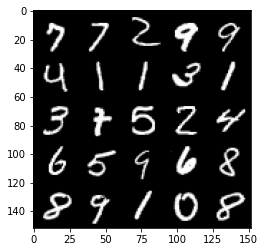

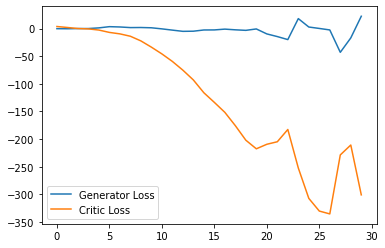

 39%|███▊      | 181/469 [00:20<00:30,  9.45it/s]

Step 650: Generator loss: 6.560768660902977, critic loss: -305.2568289489746


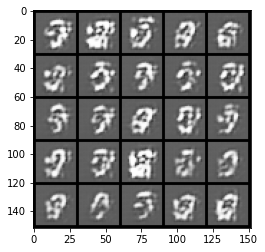

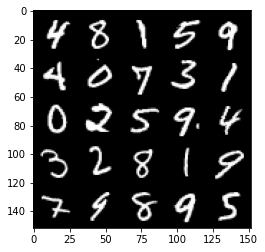

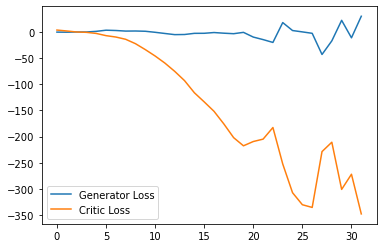

 49%|████▉     | 231/469 [00:26<00:25,  9.51it/s]

Step 700: Generator loss: 1.221199823617935, critic loss: -307.42434954833976


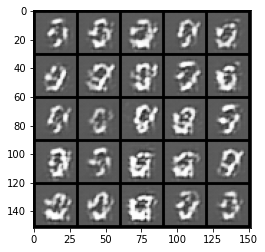

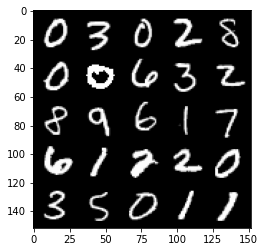

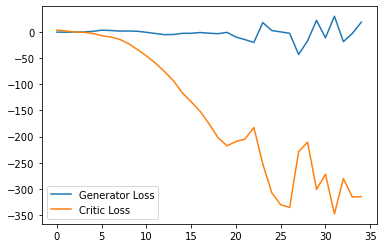

 60%|█████▉    | 281/469 [00:32<00:19,  9.43it/s]

Step 750: Generator loss: -14.754869718551635, critic loss: -297.4161125488281


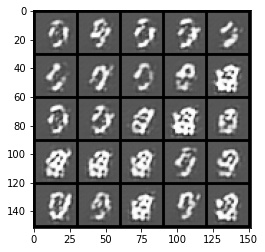

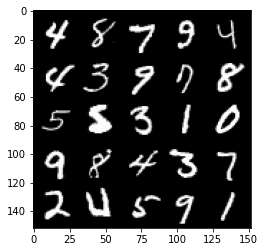

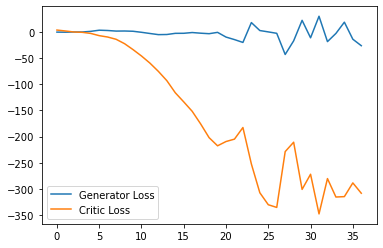

 71%|███████   | 331/469 [00:38<00:14,  9.41it/s]

Step 800: Generator loss: -8.140809360146523, critic loss: -292.3154700622558


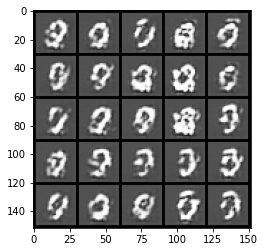

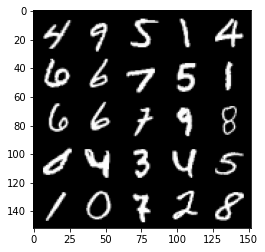

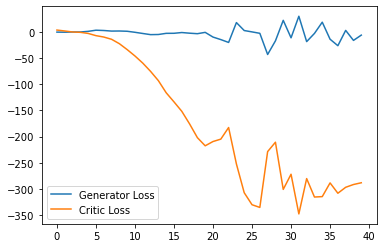

 81%|████████  | 381/469 [00:44<00:09,  9.54it/s]

Step 850: Generator loss: -8.582000753879548, critic loss: -306.88840283203126


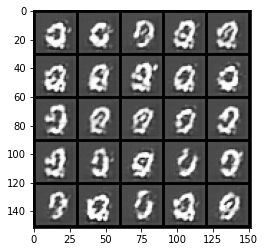

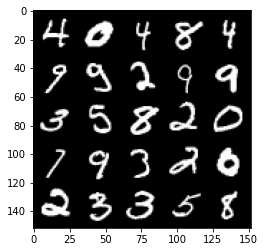

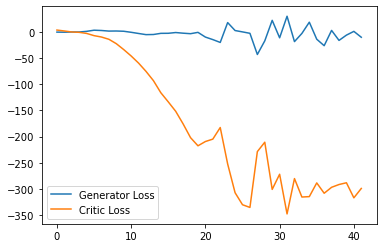

 92%|█████████▏| 431/469 [00:49<00:04,  9.43it/s]

Step 900: Generator loss: -29.16498291730881, critic loss: -299.46188604736335


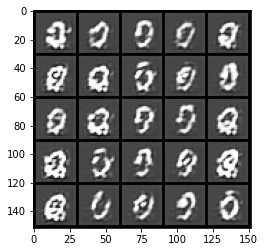

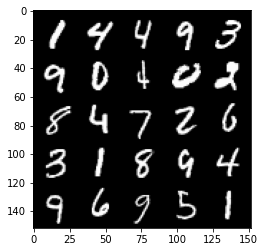

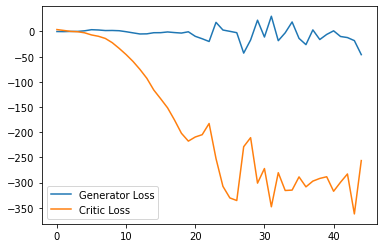

  3%|▎         | 12/469 [00:01<00:48,  9.38it/s]

Step 950: Generator loss: -33.84388053536415, critic loss: -250.74960624694816


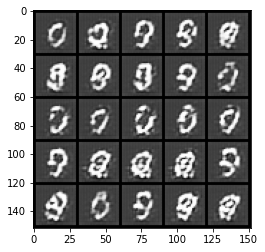

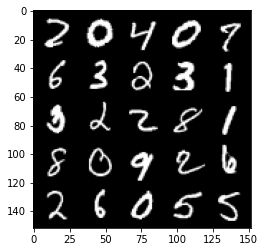

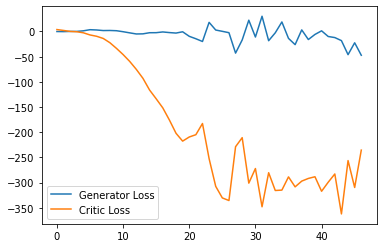

 13%|█▎        | 62/469 [00:07<00:46,  8.80it/s]

Step 1000: Generator loss: -36.66428389787674, critic loss: -182.46012030029294


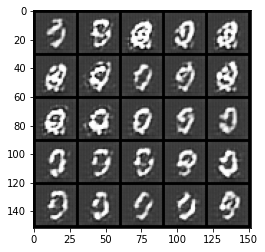

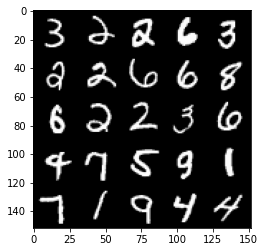

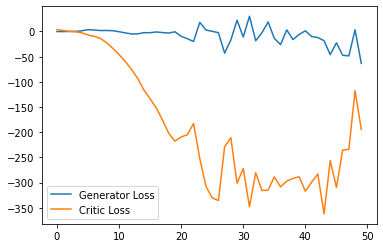

 24%|██▍       | 112/469 [00:13<00:37,  9.50it/s]

Step 1050: Generator loss: -51.03132958412171, critic loss: -205.9334892120362


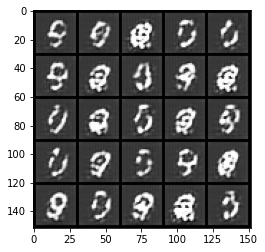

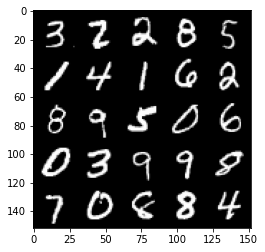

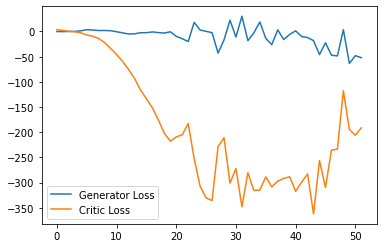

 35%|███▍      | 162/469 [00:18<00:32,  9.38it/s]

Step 1100: Generator loss: -56.94193245887757, critic loss: -189.46043605041513


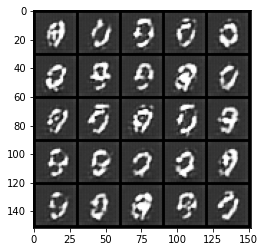

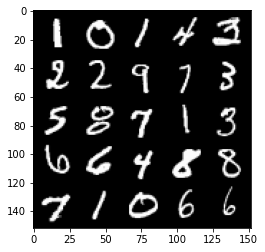

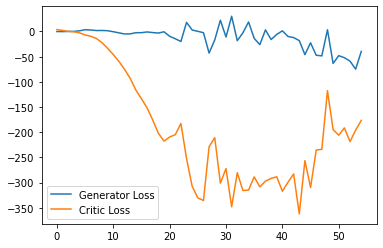

 45%|████▌     | 212/469 [00:24<00:27,  9.42it/s]

Step 1150: Generator loss: -37.54615749835968, critic loss: -142.30059642028814


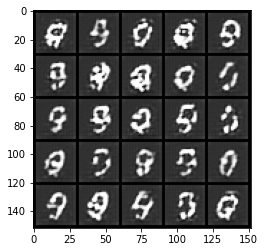

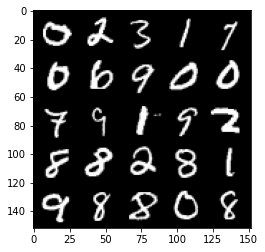

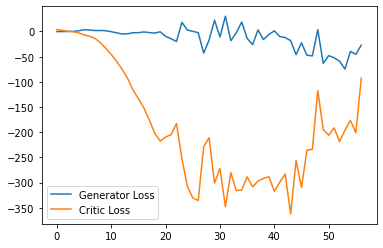

 56%|█████▌    | 262/469 [00:30<00:22,  9.12it/s]

Step 1200: Generator loss: -43.33917397499084, critic loss: -159.06453564453122


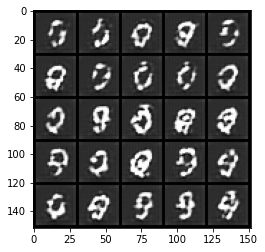

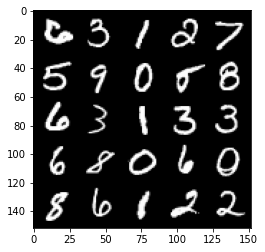

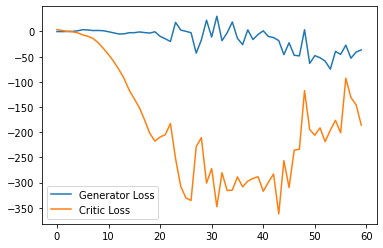

 67%|██████▋   | 312/469 [00:36<00:17,  9.10it/s]

Step 1250: Generator loss: -24.192533102035522, critic loss: -69.22146986770628


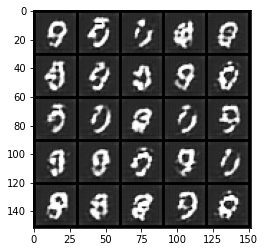

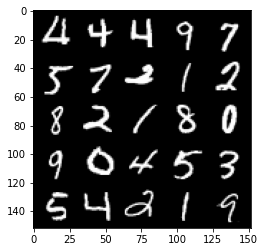

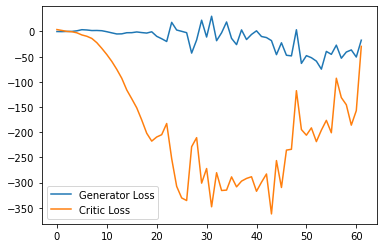

 77%|███████▋  | 362/469 [00:42<00:11,  9.15it/s]

Step 1300: Generator loss: 7.222897462844848, critic loss: 19.442910453796394


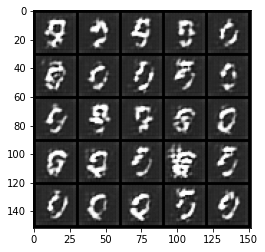

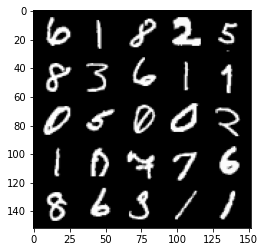

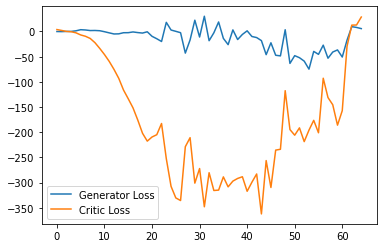

 88%|████████▊ | 412/469 [00:48<00:06,  9.20it/s]

Step 1350: Generator loss: -4.721001170277596, critic loss: 34.50658545684815


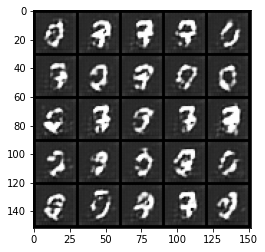

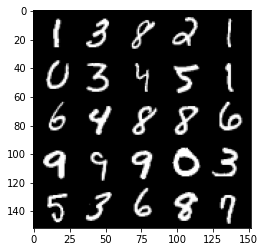

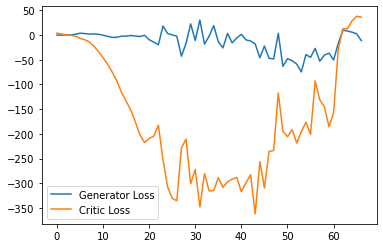

 99%|█████████▊| 462/469 [00:56<00:02,  2.63it/s]

Step 1400: Generator loss: -5.4199842727184295, critic loss: 13.777293437957763


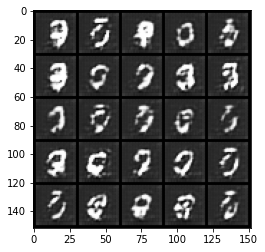

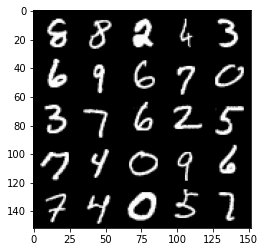

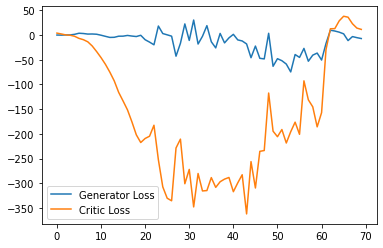

  9%|▉         | 43/469 [00:05<00:57,  7.46it/s]

Step 1450: Generator loss: -6.069958610534668, critic loss: 6.086041130065921


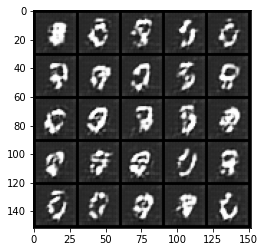

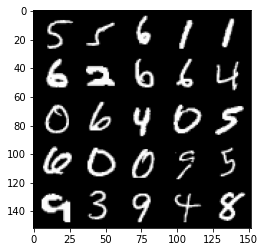

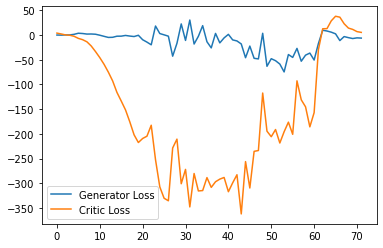

 20%|█▉        | 93/469 [00:12<00:50,  7.51it/s]

Step 1500: Generator loss: -6.285319080352783, critic loss: 3.1365652465820313


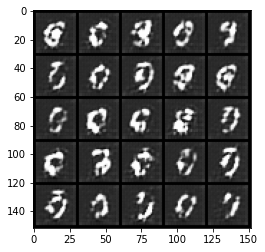

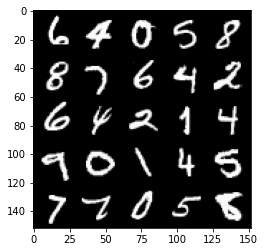

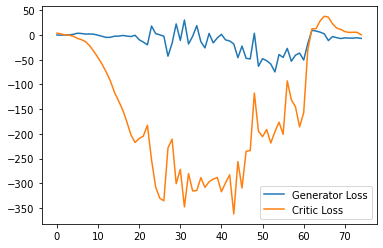

 30%|███       | 143/469 [00:20<00:43,  7.42it/s]

Step 1550: Generator loss: -8.47795522928238, critic loss: -1.412437915802002


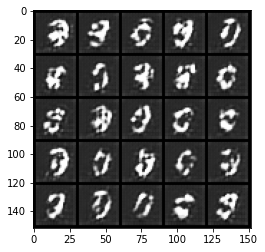

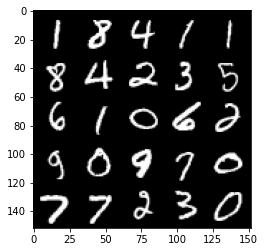

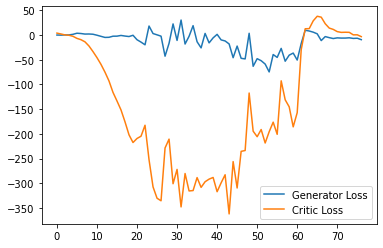

 41%|████      | 193/469 [00:27<00:36,  7.46it/s]

Step 1600: Generator loss: -12.782854151576757, critic loss: 3.266136398315431


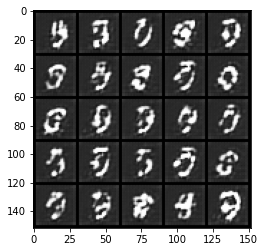

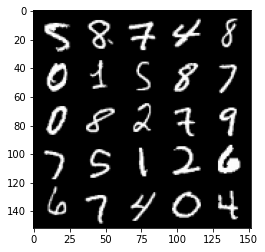

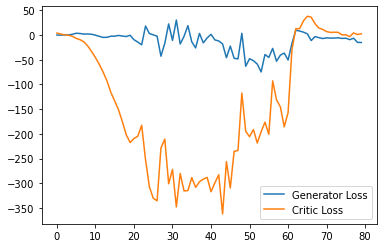

 52%|█████▏    | 243/469 [00:34<00:30,  7.49it/s]

Step 1650: Generator loss: -13.132919583320618, critic loss: -8.860475273132321


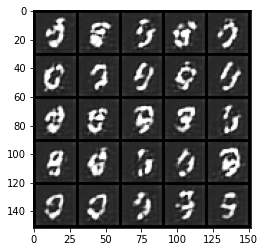

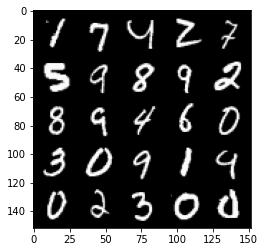

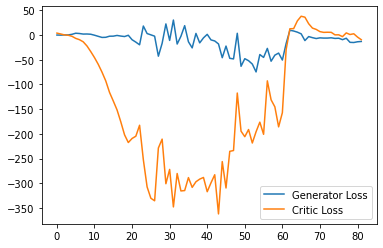

 62%|██████▏   | 293/469 [00:42<00:23,  7.47it/s]

Step 1700: Generator loss: -4.294309200495482, critic loss: 4.326883674621581


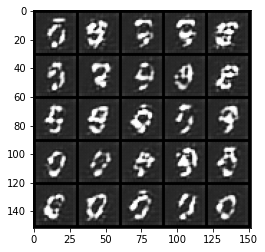

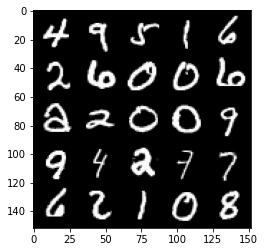

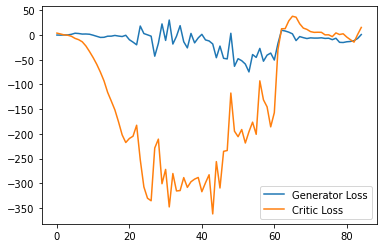

 73%|███████▎  | 343/469 [00:49<00:16,  7.48it/s]

Step 1750: Generator loss: -8.267619077265262, critic loss: 6.874202114105223


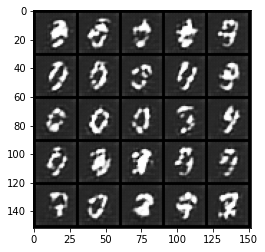

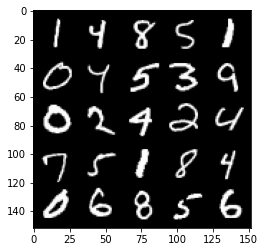

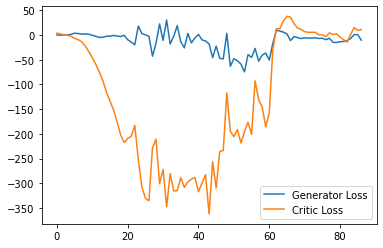

 84%|████████▍ | 393/469 [00:56<00:10,  7.40it/s]

Step 1800: Generator loss: -22.447393827438354, critic loss: -15.51641725158691


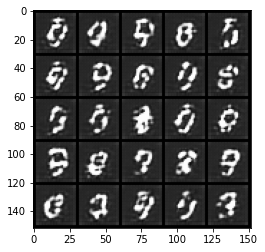

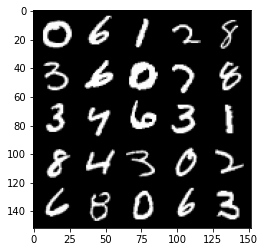

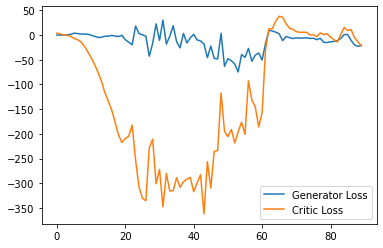

 94%|█████████▍| 443/469 [01:03<00:03,  7.43it/s]

Step 1850: Generator loss: -7.041136958301068, critic loss: -12.21276457023621


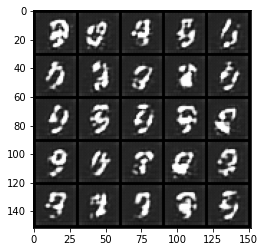

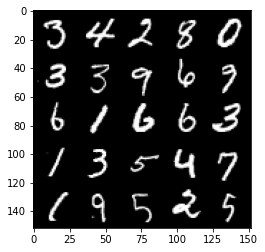

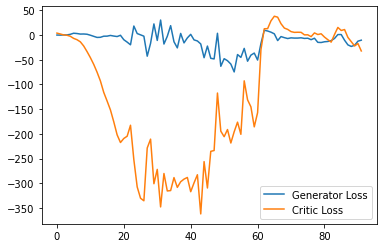

  5%|▌         | 24/469 [00:03<01:00,  7.42it/s]

Step 1900: Generator loss: -2.7429722142219544, critic loss: 6.006141946792601


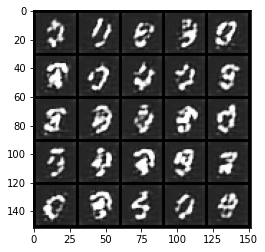

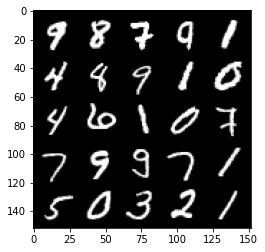

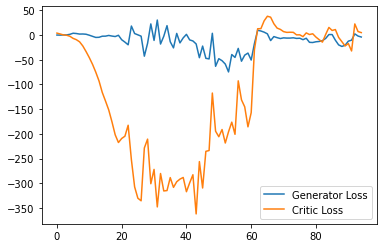

 16%|█▌        | 74/469 [00:10<00:53,  7.38it/s]

Step 1950: Generator loss: -18.14503836631775, critic loss: -19.772533523559574


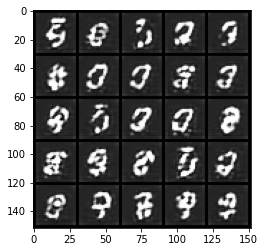

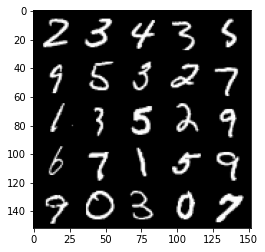

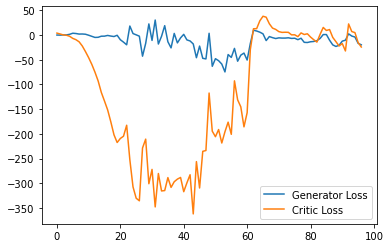

 26%|██▋       | 124/469 [00:17<00:46,  7.35it/s]

Step 2000: Generator loss: -14.531017400026322, critic loss: -28.417068794250483


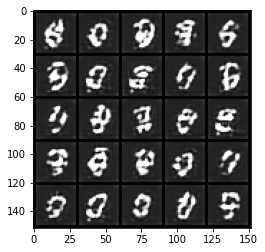

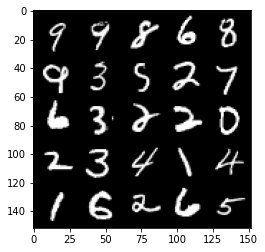

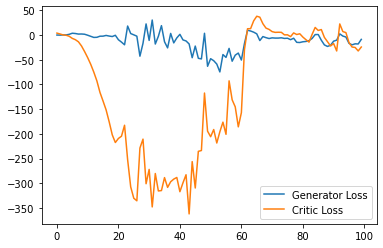

 37%|███▋      | 174/469 [00:25<00:47,  6.17it/s]

Step 2050: Generator loss: -1.1626061177253724, critic loss: 5.596503797531127


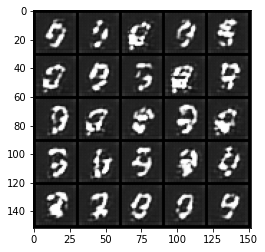

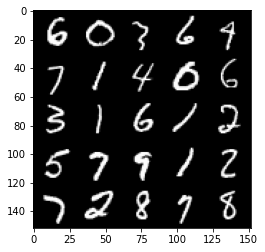

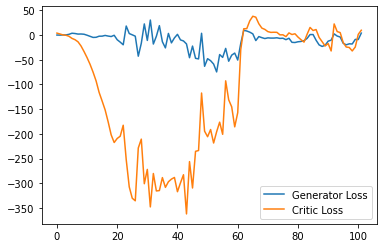

 48%|████▊     | 224/469 [00:34<00:40,  6.02it/s]

Step 2100: Generator loss: 0.18301340341567993, critic loss: 5.472033493041993


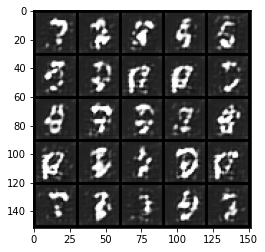

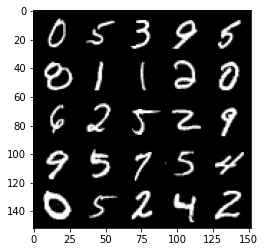

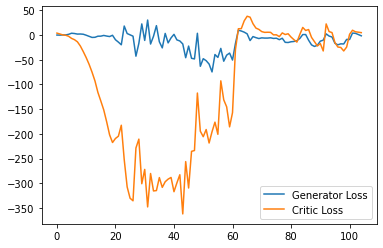

 58%|█████▊    | 274/469 [00:42<00:32,  6.05it/s]

Step 2150: Generator loss: -3.9969996976852418, critic loss: 5.585257563591004


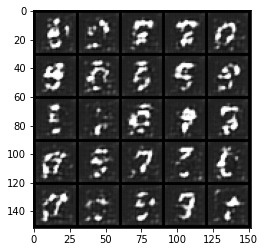

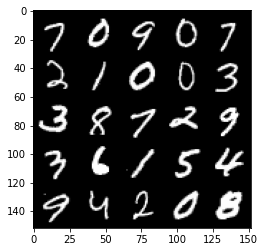

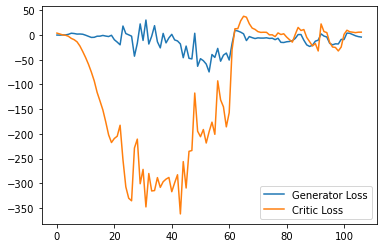

 69%|██████▉   | 324/469 [00:51<00:24,  6.04it/s]

Step 2200: Generator loss: -5.829528541564941, critic loss: 4.355091535568238


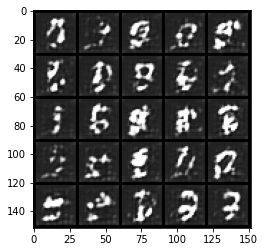

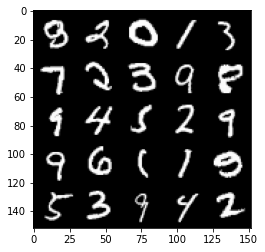

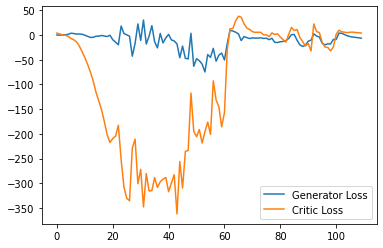

 80%|███████▉  | 374/469 [01:00<00:15,  6.16it/s]

Step 2250: Generator loss: -7.378895130157471, critic loss: 2.97268830871582


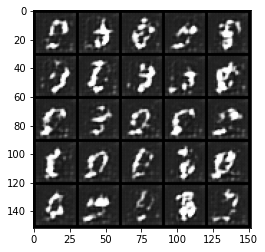

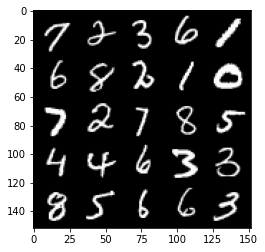

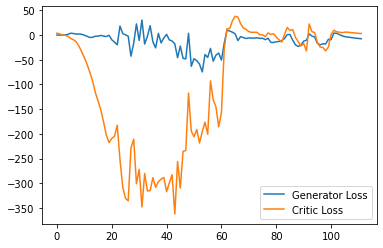

 90%|█████████ | 424/469 [01:08<00:07,  6.14it/s]

Step 2300: Generator loss: -8.007230768203735, critic loss: 3.745098356246948


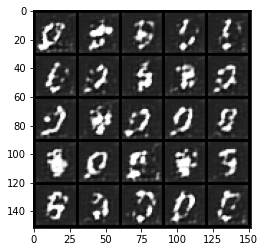

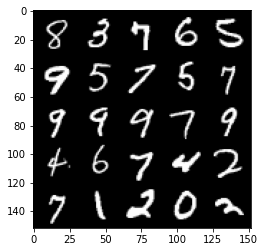

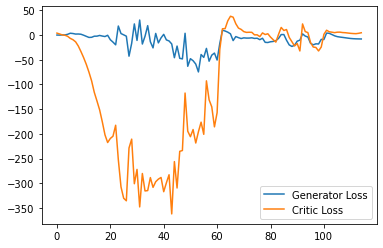

  1%|          | 5/469 [00:02<03:29,  2.22it/s]

Step 2350: Generator loss: -9.110580673217774, critic loss: 4.721234895706178


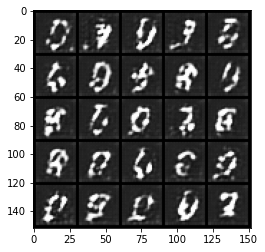

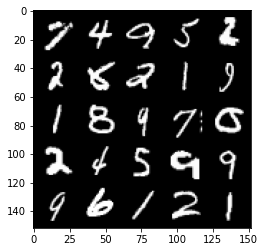

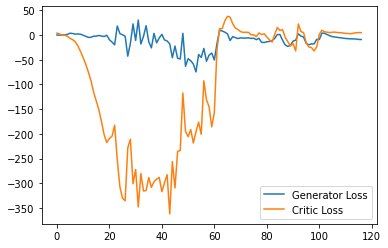

 12%|█▏        | 55/469 [00:13<01:22,  4.99it/s]

Step 2400: Generator loss: -9.934712066650391, critic loss: 3.2788043594360348


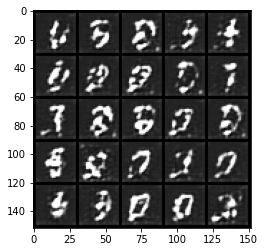

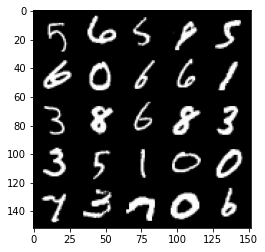

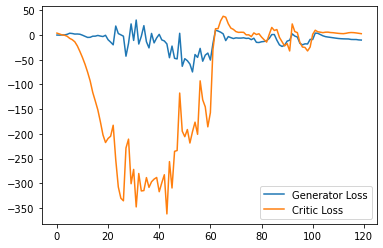

 22%|██▏       | 105/469 [00:24<01:14,  4.88it/s]

Step 2450: Generator loss: -11.870090446472169, critic loss: 0.404791795730591


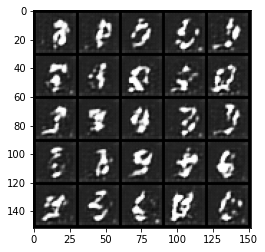

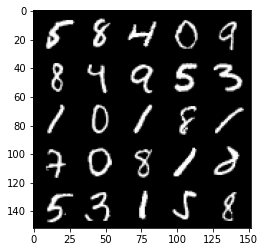

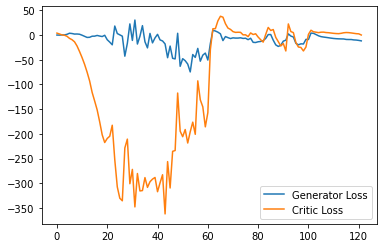

 33%|███▎      | 155/469 [00:37<02:10,  2.41it/s]

Step 2500: Generator loss: -15.479867134094238, critic loss: -5.39573271560669


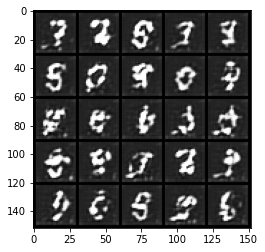

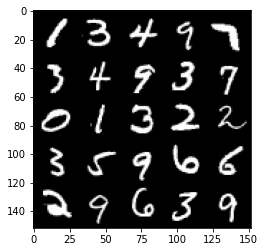

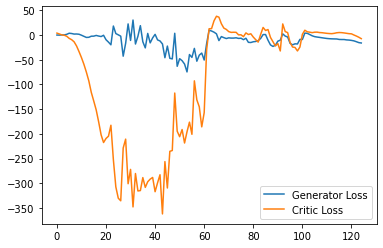

 44%|████▎     | 205/469 [00:49<01:21,  3.25it/s]

Step 2550: Generator loss: -17.940470180511475, critic loss: -11.733309543609622


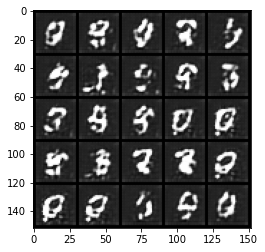

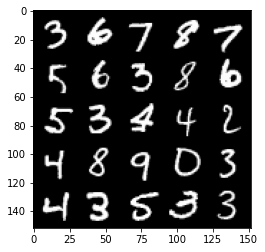

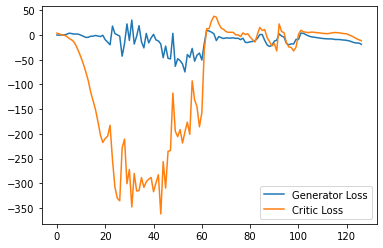

 54%|█████▍    | 255/469 [01:03<00:45,  4.71it/s]

Step 2600: Generator loss: -18.029488573074342, critic loss: -11.512473523139954


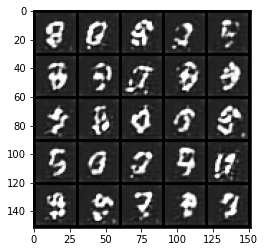

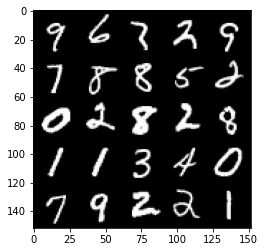

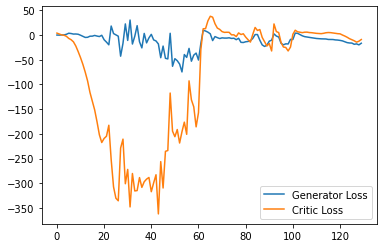

 65%|██████▌   | 305/469 [01:14<00:31,  5.16it/s]

Step 2650: Generator loss: -19.11587044239044, critic loss: -16.254319261550908


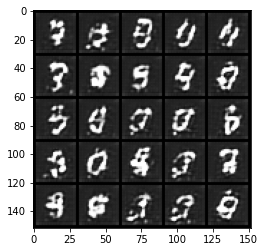

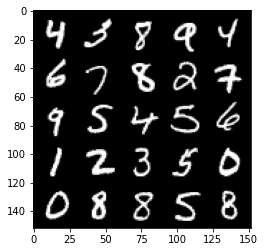

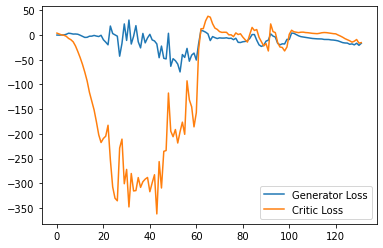

 76%|███████▌  | 355/469 [01:25<00:23,  4.91it/s]

Step 2700: Generator loss: -19.139811315536498, critic loss: -17.481173500061033


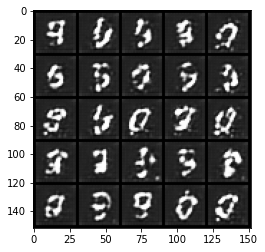

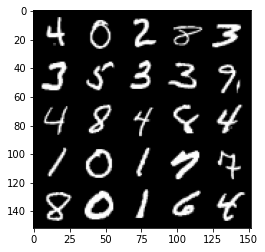

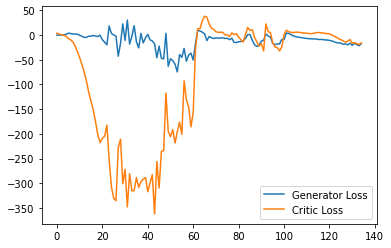

 86%|████████▋ | 405/469 [01:39<00:15,  4.13it/s]

Step 2750: Generator loss: -16.936942395567893, critic loss: -17.7190421962738


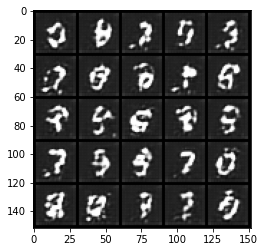

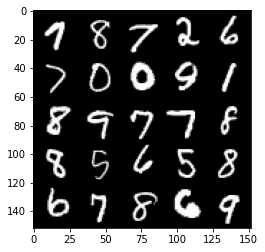

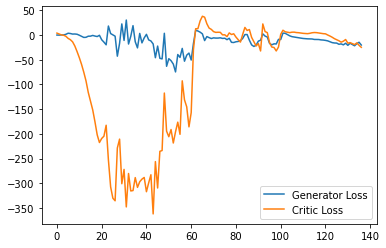

 97%|█████████▋| 455/469 [01:55<00:04,  2.81it/s]

Step 2800: Generator loss: -12.99656394958496, critic loss: -3.6943254041671754


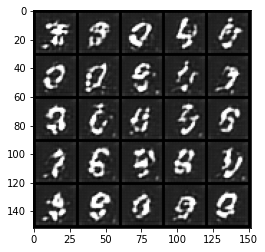

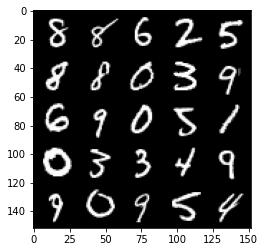

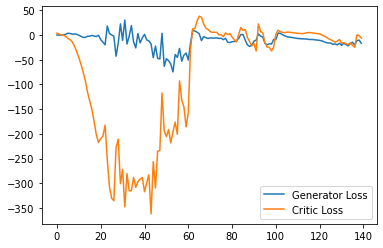

  8%|▊         | 36/469 [00:08<01:34,  4.59it/s]

Step 2850: Generator loss: -23.00951862335205, critic loss: -23.380977848052975


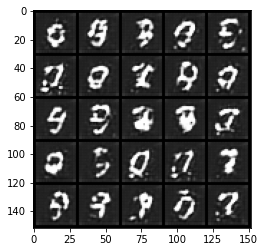

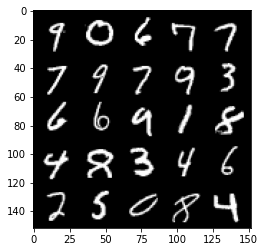

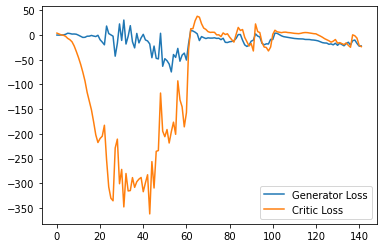

 18%|█▊        | 86/469 [00:19<01:14,  5.17it/s]

Step 2900: Generator loss: -18.54011106491089, critic loss: -23.264816457748406


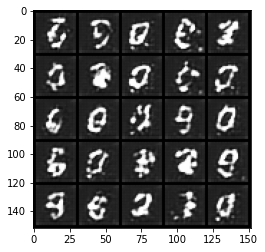

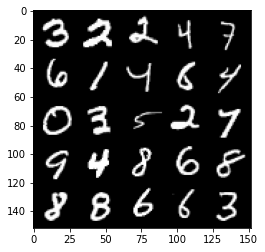

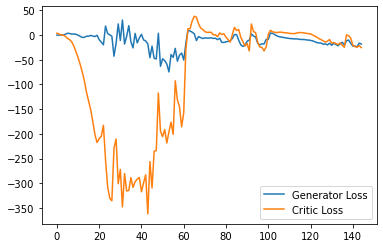

 29%|██▉       | 136/469 [00:33<01:16,  4.32it/s]

Step 2950: Generator loss: -19.234906642436982, critic loss: -26.93808562850952


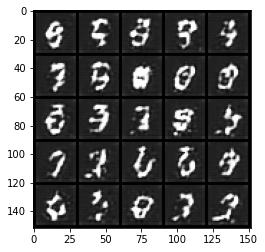

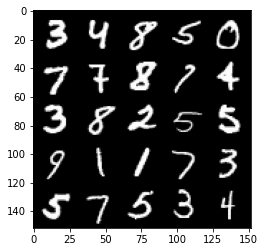

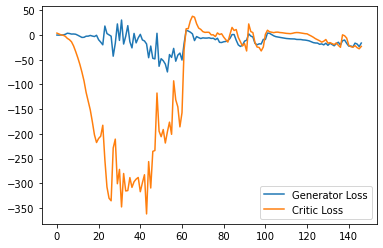

 40%|███▉      | 186/469 [00:47<00:57,  4.93it/s]

Step 3000: Generator loss: -16.629112596511842, critic loss: -26.839654245376586


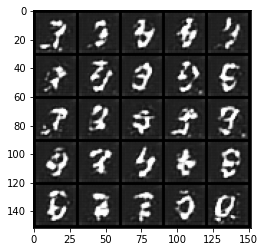

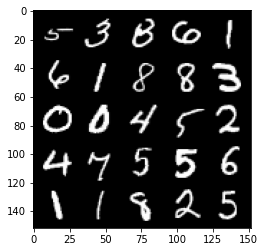

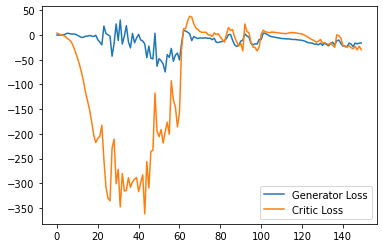

 50%|█████     | 236/469 [01:01<00:53,  4.38it/s]

Step 3050: Generator loss: -17.17717737942934, critic loss: -26.48850854682922


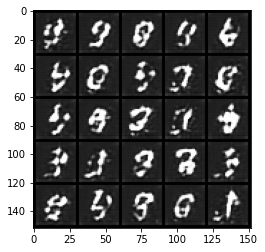

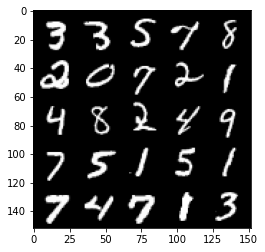

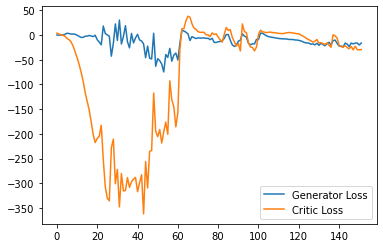

 61%|██████    | 286/469 [01:13<00:39,  4.65it/s]

Step 3100: Generator loss: -16.824531195163726, critic loss: -28.816211847305297


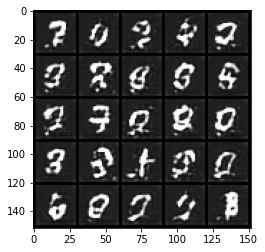

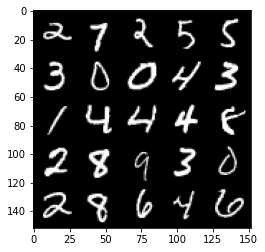

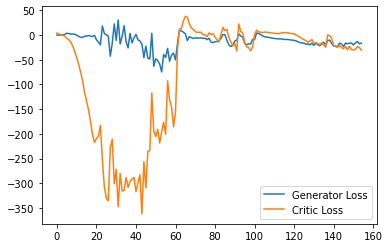

 72%|███████▏  | 336/469 [01:26<00:35,  3.79it/s]

Step 3150: Generator loss: -7.009209332466125, critic loss: -1.3009098687171943


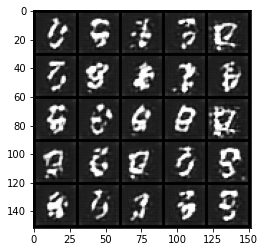

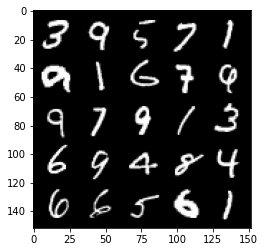

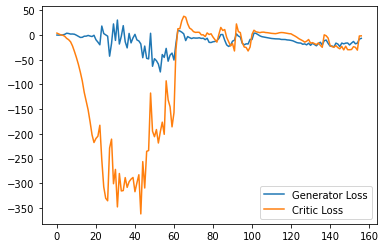

 82%|████████▏ | 386/469 [01:38<00:17,  4.70it/s]

Step 3200: Generator loss: -13.657413549423218, critic loss: -11.972331799507142


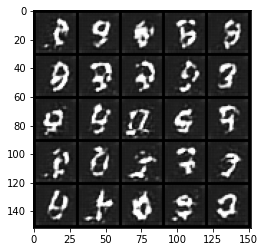

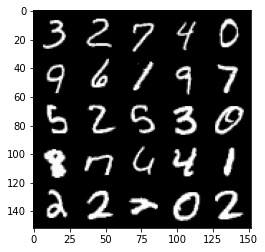

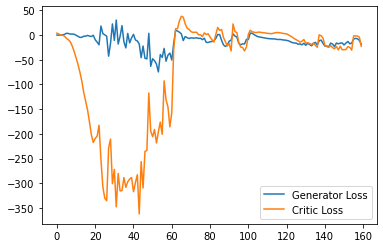

 93%|█████████▎| 436/469 [01:53<00:08,  4.00it/s]

Step 3250: Generator loss: -21.086936683654784, critic loss: -28.566868671417247


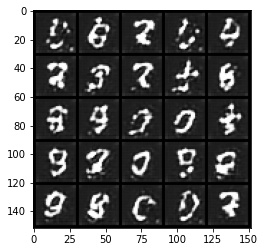

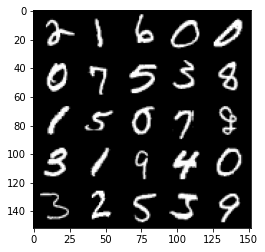

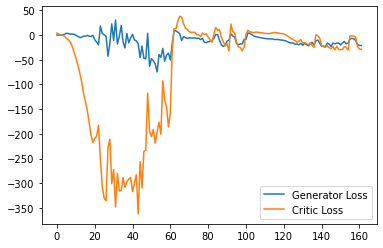

  4%|▎         | 17/469 [00:04<01:50,  4.10it/s]

Step 3300: Generator loss: -17.441423206329347, critic loss: -26.83669884109497


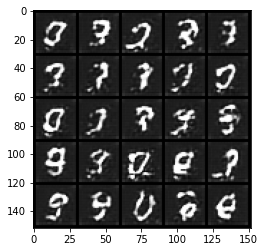

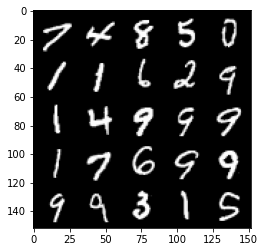

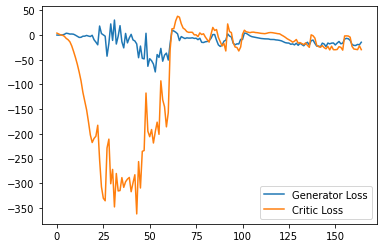

 14%|█▍        | 67/469 [00:20<02:56,  2.28it/s]

Step 3350: Generator loss: -15.414733476638794, critic loss: -26.576281223297123


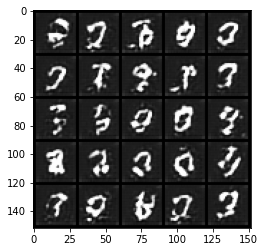

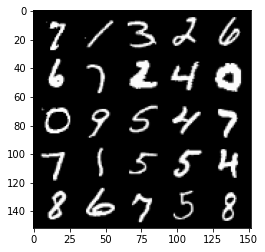

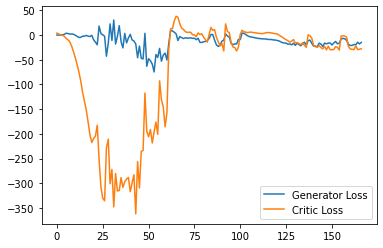

 25%|██▍       | 117/469 [00:34<01:19,  4.43it/s]

Step 3400: Generator loss: -8.671427669748663, critic loss: -9.854286971092224


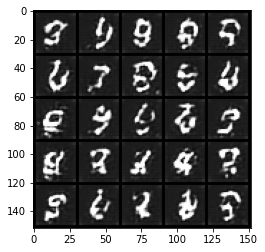

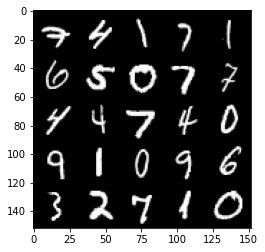

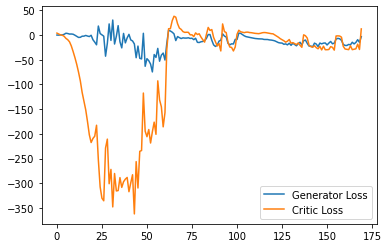

 36%|███▌      | 167/469 [00:48<01:09,  4.33it/s]

Step 3450: Generator loss: -5.34668240070343, critic loss: -1.793632756233215


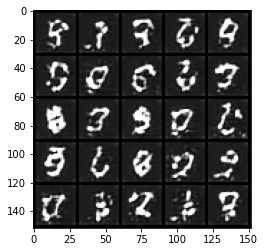

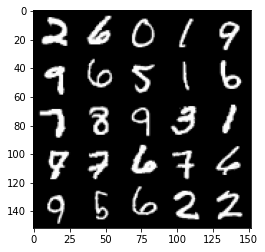

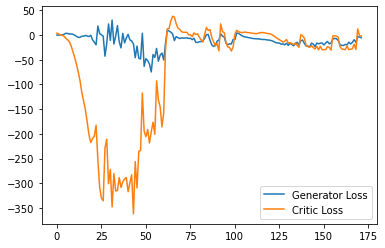

 46%|████▋     | 217/469 [01:01<01:05,  3.82it/s]

Step 3500: Generator loss: -9.746550703048706, critic loss: -1.6866867260932923


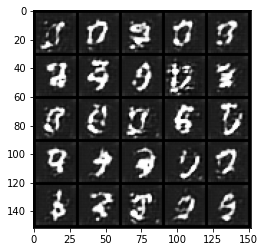

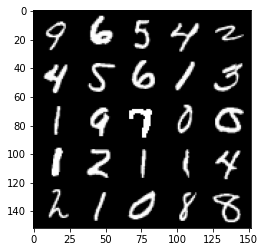

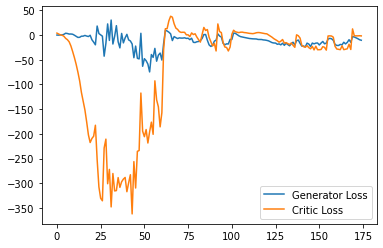

 57%|█████▋    | 267/469 [01:19<01:09,  2.92it/s]

Step 3550: Generator loss: -12.49760705947876, critic loss: -2.2652081651687626


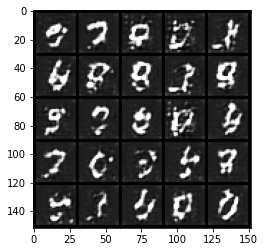

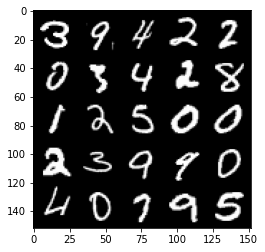

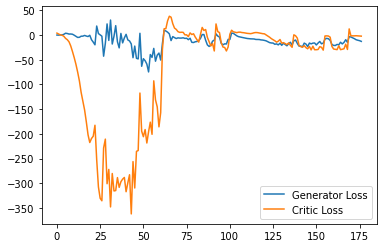

 68%|██████▊   | 317/469 [01:34<00:39,  3.87it/s]

Step 3600: Generator loss: -14.364806003570557, critic loss: -4.7770233368873605


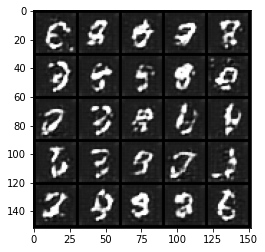

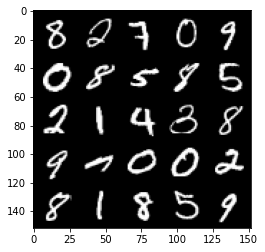

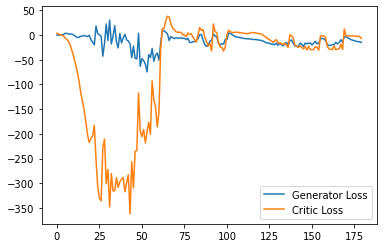

 78%|███████▊  | 367/469 [01:51<00:35,  2.87it/s]

Step 3650: Generator loss: -26.39094425201416, critic loss: -28.707509941101065


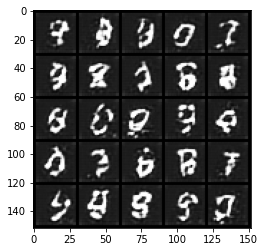

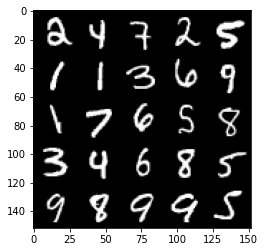

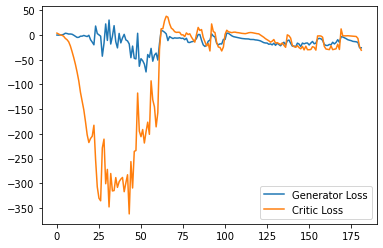

 89%|████████▉ | 417/469 [02:05<00:12,  4.30it/s]

Step 3700: Generator loss: -23.926736373901367, critic loss: -27.392657964706423


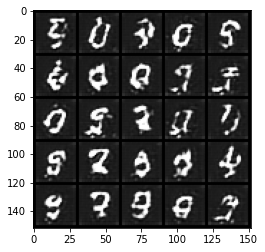

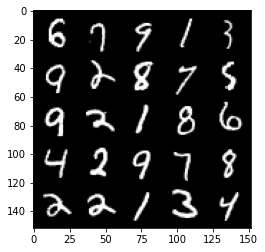

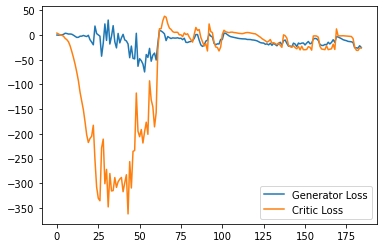

100%|█████████▉| 467/469 [02:18<00:00,  5.07it/s]

Step 3750: Generator loss: -23.78223220348358, critic loss: -29.785747436523447


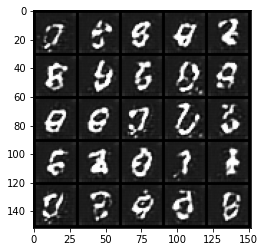

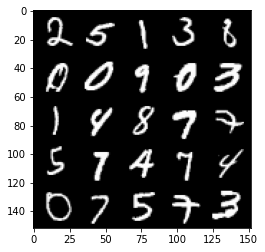

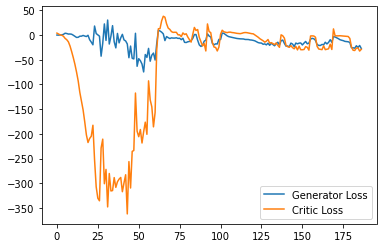

 10%|█         | 48/469 [00:13<02:20,  2.99it/s]

Step 3800: Generator loss: -16.745749127864837, critic loss: -16.21302939987183


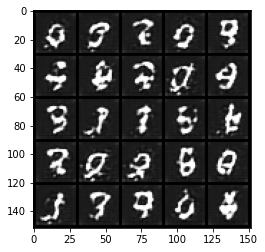

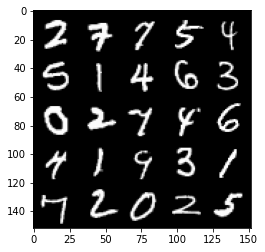

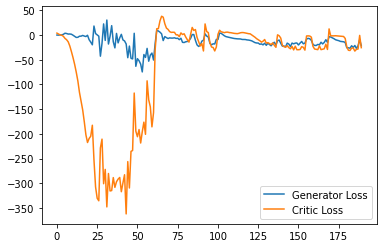

 21%|██        | 98/469 [00:28<01:13,  5.05it/s]

Step 3850: Generator loss: -13.141899800300598, critic loss: -8.022503399372098


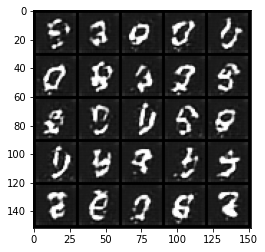

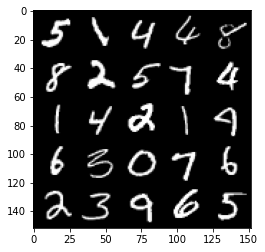

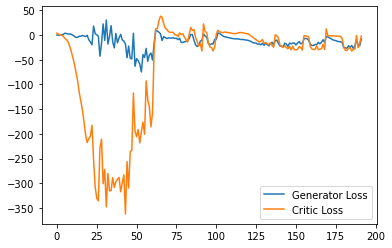

 32%|███▏      | 148/469 [00:45<02:05,  2.56it/s]

Step 3900: Generator loss: -9.571353416442872, critic loss: -3.2520997495651245


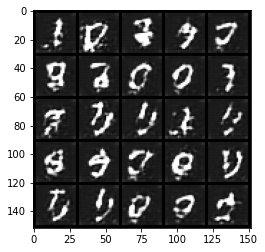

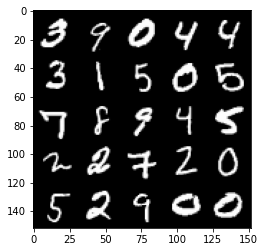

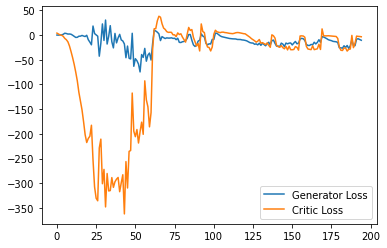

 42%|████▏     | 198/469 [01:01<01:04,  4.20it/s]

Step 3950: Generator loss: -22.92407844543457, critic loss: -19.733600724220278


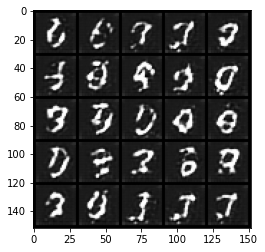

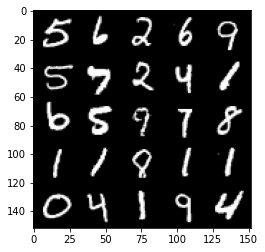

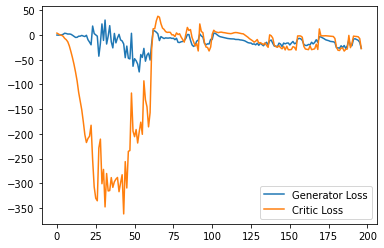

 53%|█████▎    | 248/469 [01:15<01:01,  3.58it/s]

Step 4000: Generator loss: -22.056250348091126, critic loss: -21.306704627990715


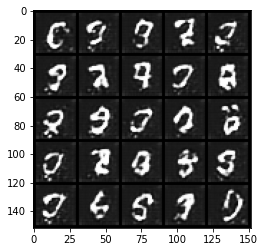

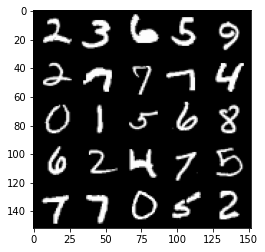

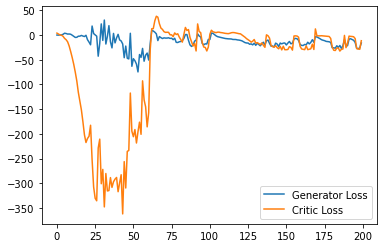

 64%|██████▎   | 298/469 [01:28<00:39,  4.35it/s]

Step 4050: Generator loss: -26.785459098815917, critic loss: -29.28777515125276


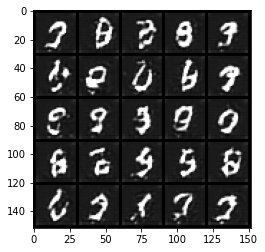

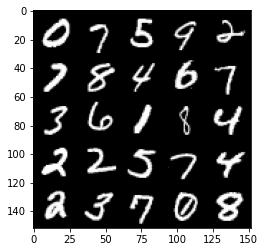

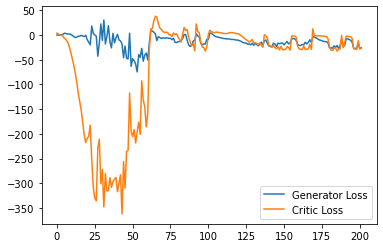

 74%|███████▍  | 348/469 [01:45<00:43,  2.76it/s]

Step 4100: Generator loss: -24.17586630821228, critic loss: -27.477330335617076


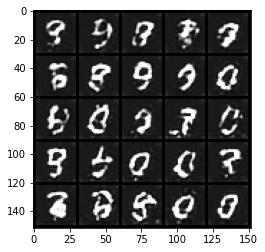

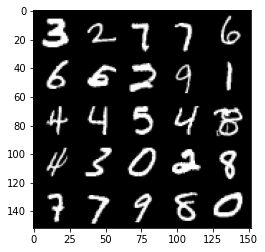

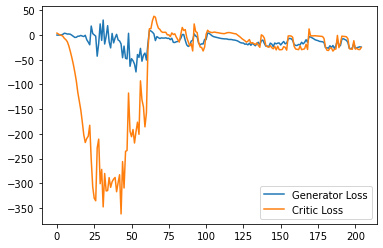

 85%|████████▍ | 398/469 [02:02<00:21,  3.30it/s]

Step 4150: Generator loss: -20.94443968296051, critic loss: -22.043713535308843


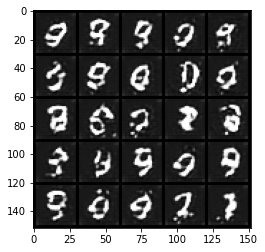

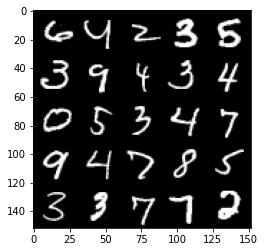

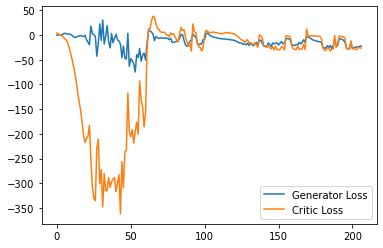

 96%|█████████▌| 448/469 [02:16<00:06,  3.34it/s]

Step 4200: Generator loss: -21.128814113140105, critic loss: -23.145653405189528


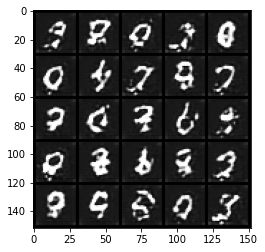

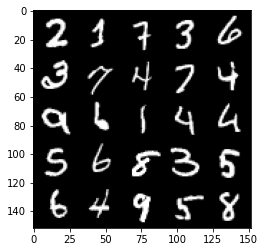

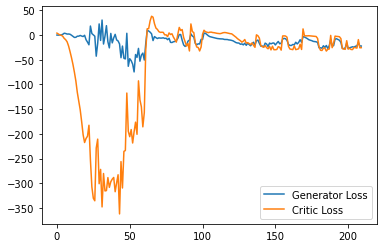

  6%|▌         | 29/469 [00:08<01:36,  4.58it/s]

Step 4250: Generator loss: -15.720113258361817, critic loss: -1.6396914873123123


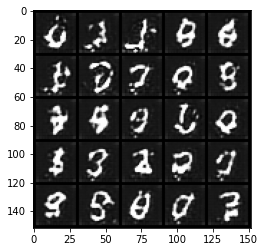

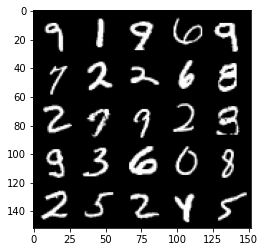

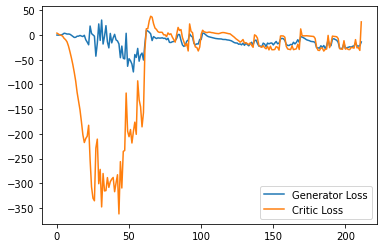

 17%|█▋        | 79/469 [00:27<01:44,  3.73it/s]

Step 4300: Generator loss: -9.35246841430664, critic loss: -1.5746010317802428


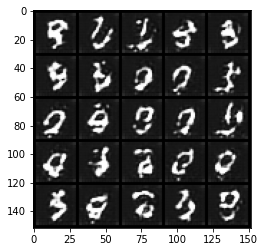

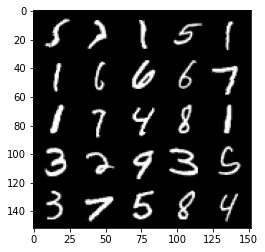

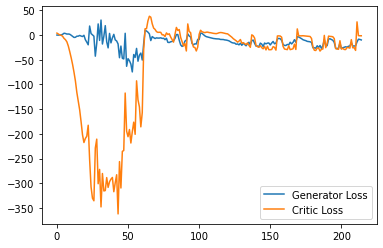

 28%|██▊       | 129/469 [00:47<01:46,  3.18it/s]

Step 4350: Generator loss: -12.80763708114624, critic loss: -1.5355575470924379


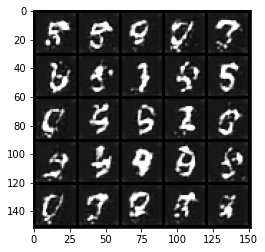

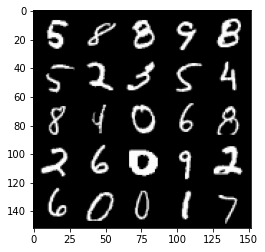

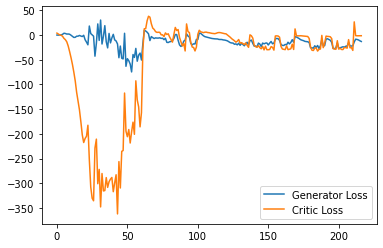

 38%|███▊      | 179/469 [01:06<01:58,  2.45it/s]

Step 4400: Generator loss: -16.04217948913574, critic loss: -1.5849627184867856


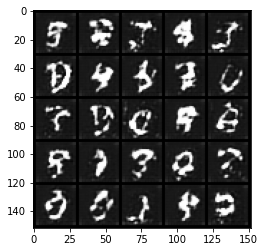

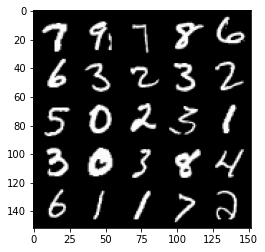

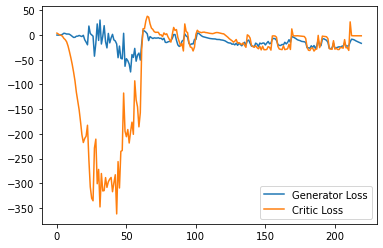

 49%|████▉     | 229/469 [01:22<01:41,  2.38it/s]

Step 4450: Generator loss: -18.766252937316896, critic loss: -1.7752538895606995


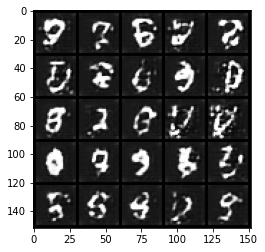

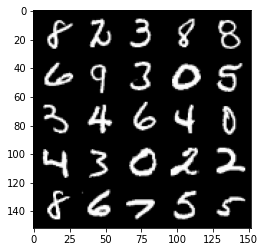

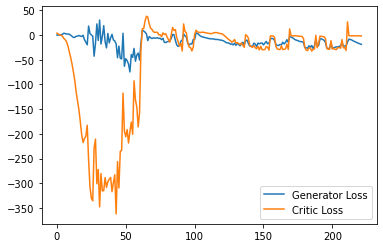

 59%|█████▉    | 279/469 [01:39<00:43,  4.32it/s]

Step 4500: Generator loss: -20.505511054992677, critic loss: -1.8718643531799315


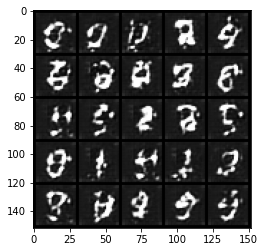

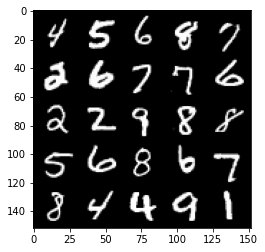

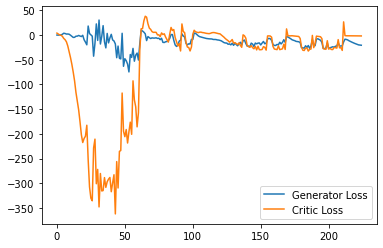

 70%|███████   | 329/469 [01:52<00:46,  3.01it/s]

Step 4550: Generator loss: -20.959310874938964, critic loss: -2.0992721080780026


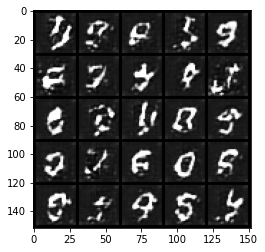

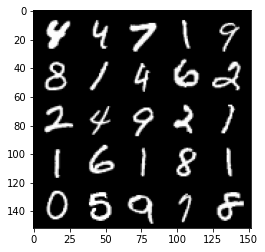

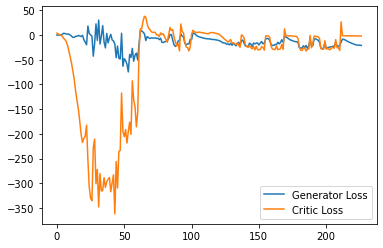

 81%|████████  | 379/469 [02:04<00:19,  4.73it/s]

Step 4600: Generator loss: -20.563009719848633, critic loss: -2.821524813652039


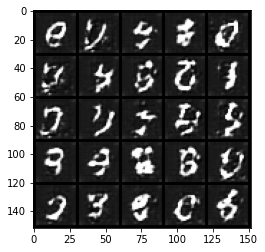

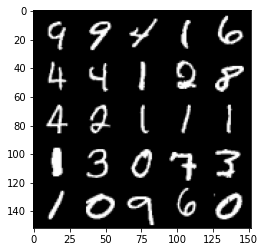

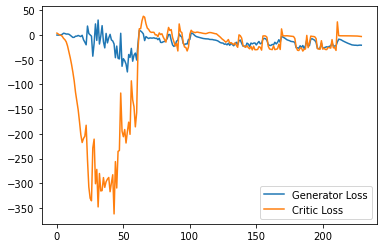

 91%|█████████▏| 429/469 [02:23<00:11,  3.61it/s]

Step 4650: Generator loss: -21.0282580947876, critic loss: -4.048977544784545


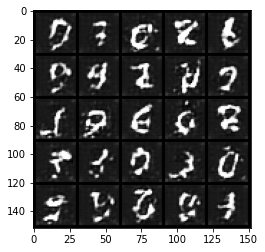

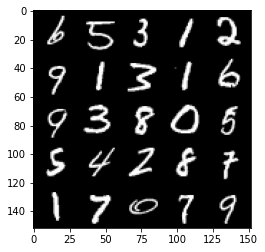

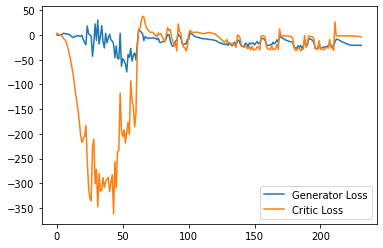

  2%|▏         | 10/469 [00:02<01:57,  3.90it/s]

Step 4700: Generator loss: -23.614788208007813, critic loss: -9.551224714279174


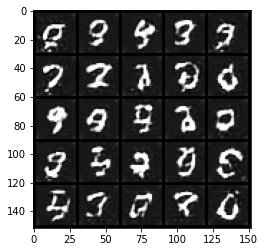

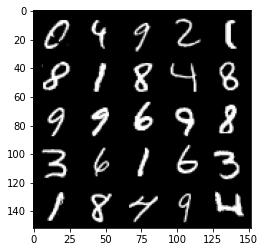

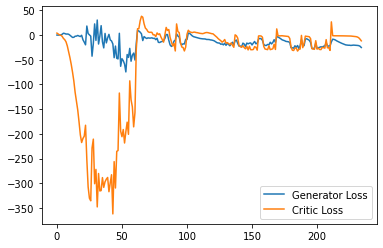

 13%|█▎        | 60/469 [00:18<02:26,  2.80it/s]

Step 4750: Generator loss: -22.944986820220947, critic loss: -11.529518414497375


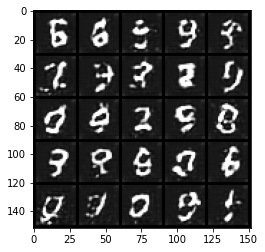

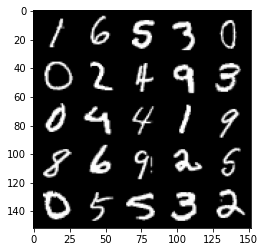

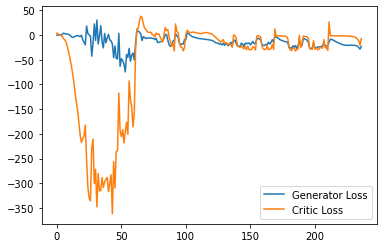

 23%|██▎       | 110/469 [00:34<01:57,  3.05it/s]

Step 4800: Generator loss: -18.811373906135557, critic loss: -11.047750172615052


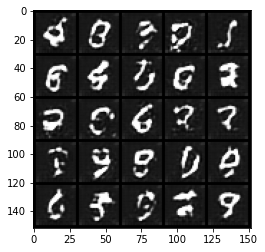

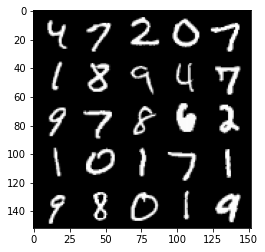

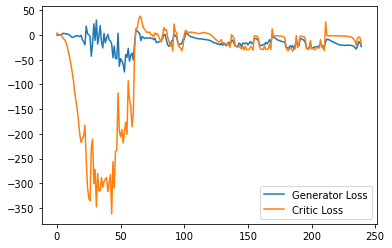

 34%|███▍      | 160/469 [00:48<01:28,  3.49it/s]

Step 4850: Generator loss: -16.117757349014283, critic loss: -2.9103311481475824


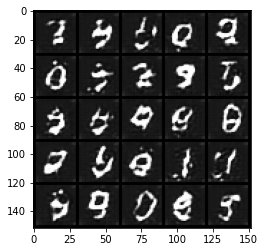

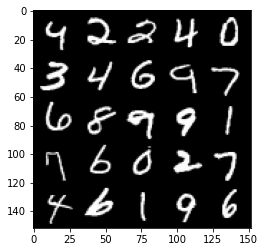

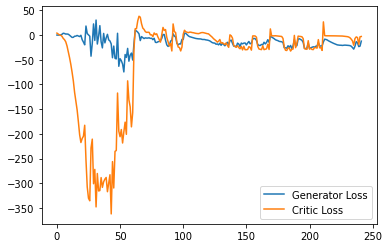

 45%|████▍     | 210/469 [01:04<01:01,  4.23it/s]

Step 4900: Generator loss: -17.04440267562866, critic loss: -9.195455218315125


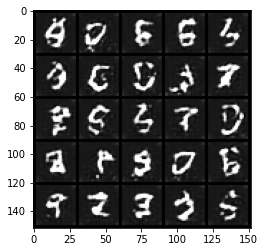

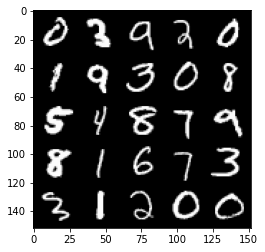

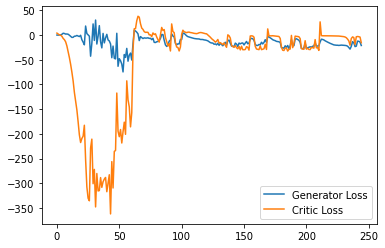

 55%|█████▌    | 260/469 [01:16<00:40,  5.12it/s]

Step 4950: Generator loss: -28.481917781829836, critic loss: -26.627839293479916


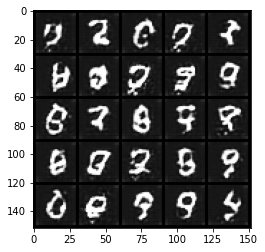

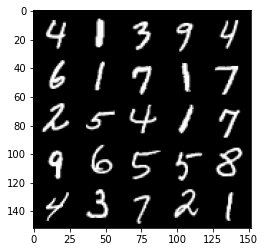

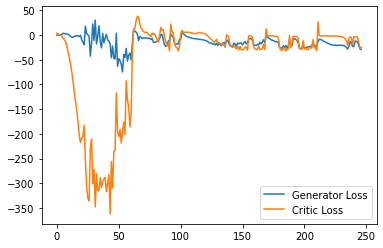

 66%|██████▌   | 310/469 [01:32<00:58,  2.72it/s]

Step 5000: Generator loss: -17.700216159820556, critic loss: -8.808331707477572


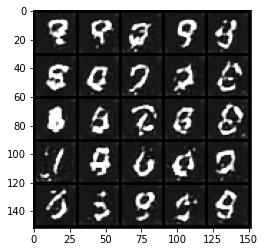

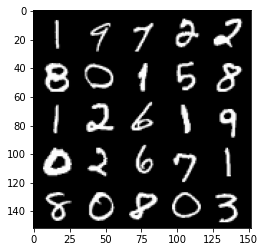

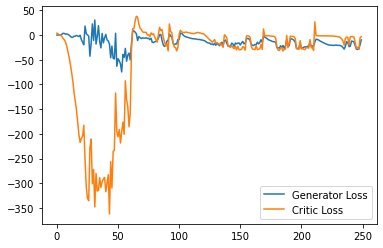

 77%|███████▋  | 360/469 [01:51<00:44,  2.46it/s]

Step 5050: Generator loss: -12.893566703796386, critic loss: -4.273231436729431


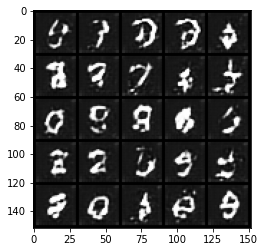

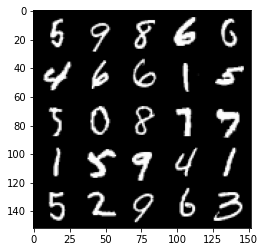

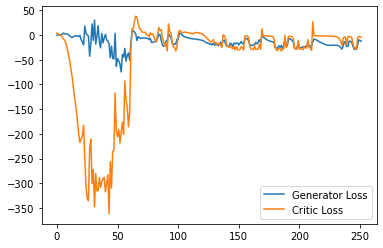

 87%|████████▋ | 410/469 [02:06<00:12,  4.58it/s]

Step 5100: Generator loss: -22.801066360473634, critic loss: -21.661349196434024


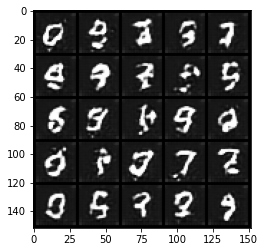

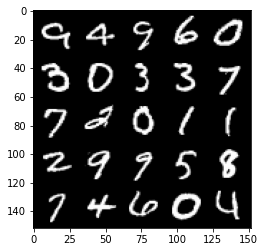

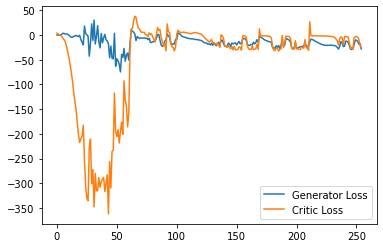

 98%|█████████▊| 460/469 [02:18<00:01,  4.76it/s]

Step 5150: Generator loss: -24.97777858495712, critic loss: -26.26137429714203


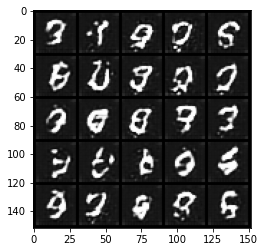

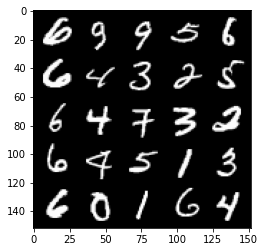

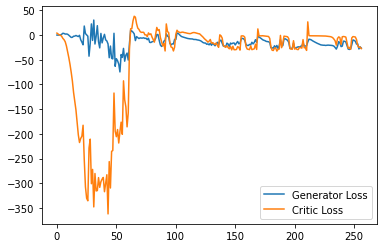

  9%|▊         | 41/469 [00:13<02:48,  2.55it/s]

Step 5200: Generator loss: -25.056893904209137, critic loss: -24.203951269149776


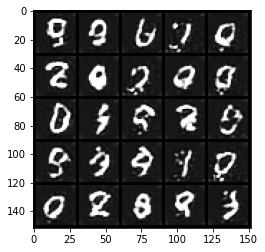

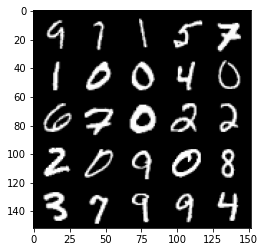

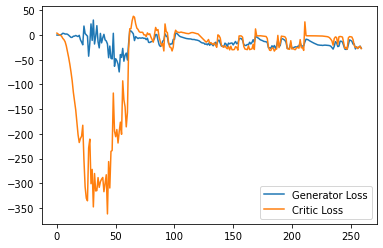

 19%|█▉        | 91/469 [00:29<01:23,  4.52it/s]

Step 5250: Generator loss: -24.063416595458985, critic loss: -12.42897335910797


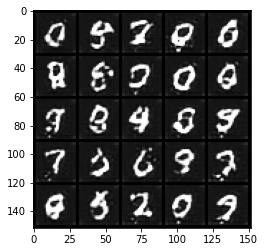

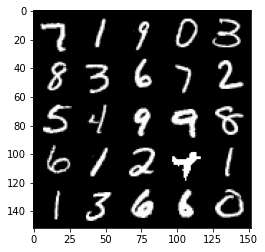

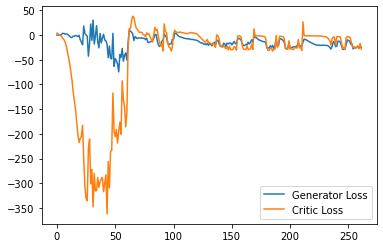

 30%|███       | 141/469 [00:44<01:26,  3.81it/s]

Step 5300: Generator loss: -8.791479930877685, critic loss: -1.9125747804641722


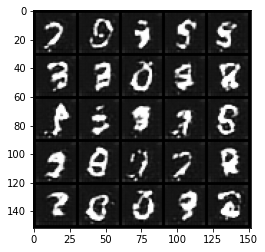

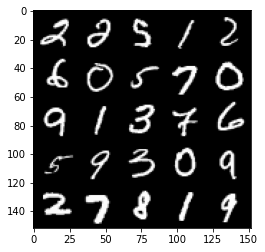

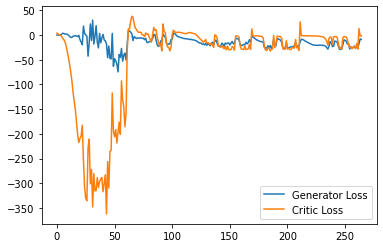

 41%|████      | 191/469 [01:04<01:28,  3.14it/s]

Step 5350: Generator loss: -12.762307453155518, critic loss: -1.7884974279403678


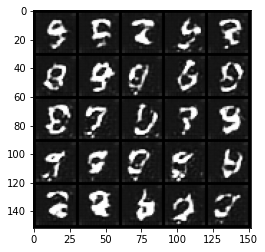

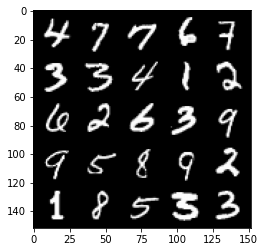

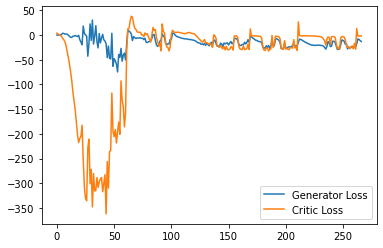

 51%|█████▏    | 241/469 [01:17<01:09,  3.29it/s]

Step 5400: Generator loss: -15.633211116790772, critic loss: -2.088102962970733


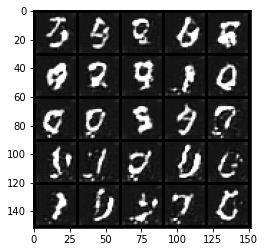

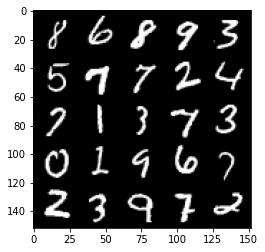

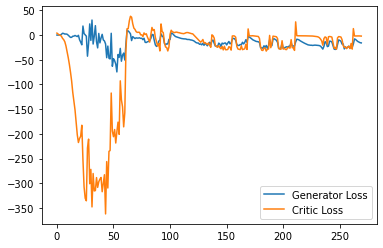

 62%|██████▏   | 291/469 [01:31<00:52,  3.37it/s]

Step 5450: Generator loss: -15.77319480895996, critic loss: -2.447607689380646


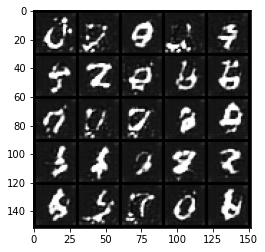

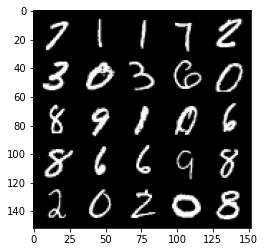

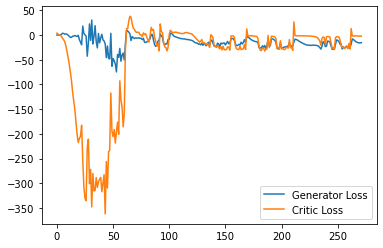

 73%|███████▎  | 341/469 [01:53<00:57,  2.22it/s]

Step 5500: Generator loss: -15.846542415618897, critic loss: -2.6462030200958253


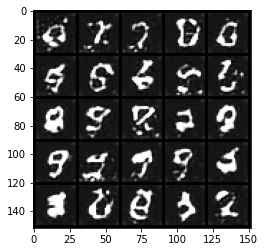

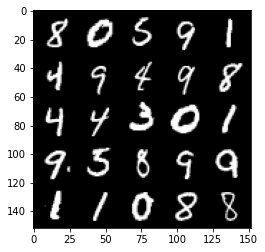

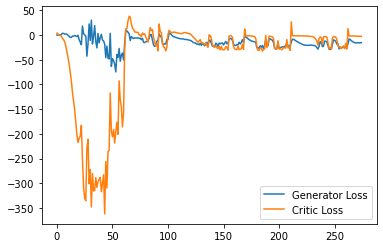

 83%|████████▎ | 391/469 [02:16<00:35,  2.22it/s]

Step 5550: Generator loss: -15.46736198425293, critic loss: -2.8806504945755007


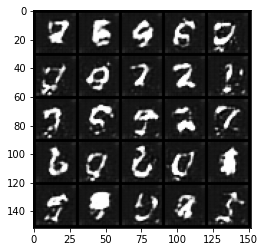

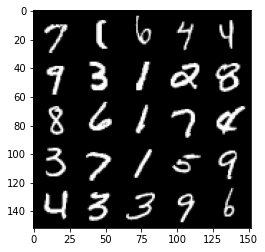

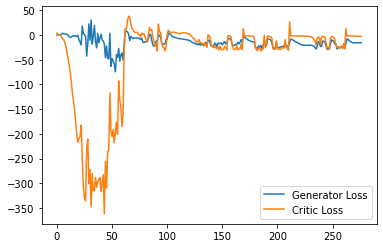

 94%|█████████▍| 441/469 [02:39<00:12,  2.22it/s]

Step 5600: Generator loss: -15.557748794555664, critic loss: -2.7902772955894477


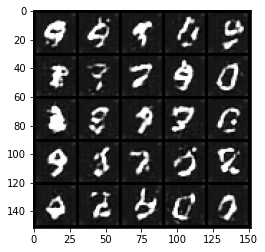

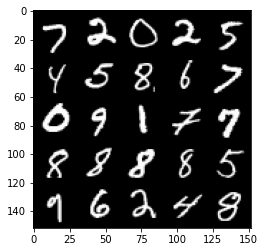

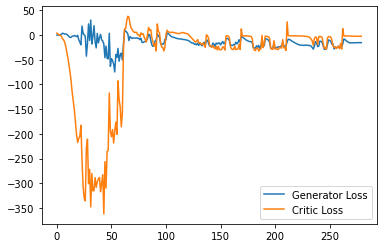

  5%|▍         | 22/469 [00:09<03:20,  2.22it/s]

Step 5650: Generator loss: -15.247004718780518, critic loss: -2.8944176592826847


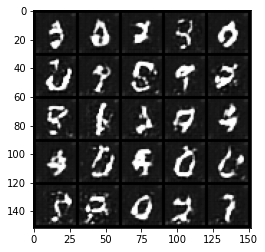

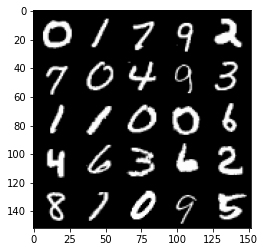

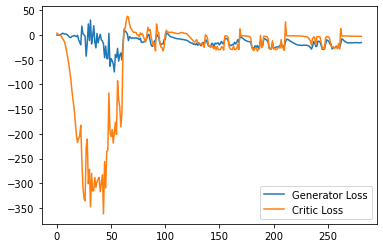

 15%|█▌        | 72/469 [00:18<01:02,  6.34it/s]

Step 5700: Generator loss: -13.675736122131347, critic loss: -4.582917985916138


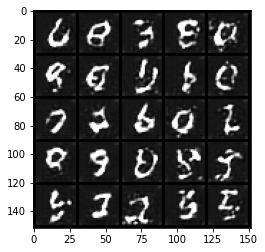

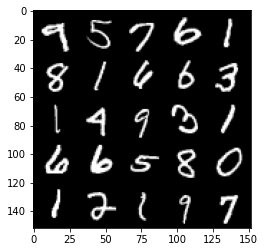

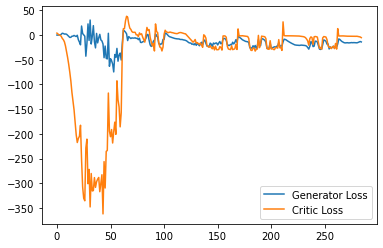

 26%|██▌       | 122/469 [00:26<00:54,  6.38it/s]

Step 5750: Generator loss: -22.666750259399414, critic loss: -13.59452589607239


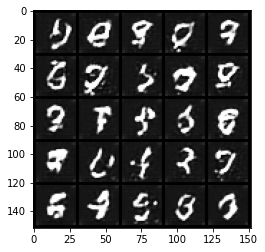

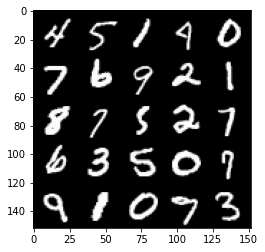

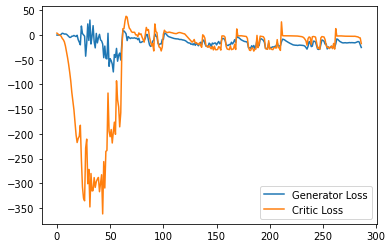

 37%|███▋      | 172/469 [00:44<02:02,  2.43it/s]

Step 5800: Generator loss: -14.356389694213867, critic loss: -11.170657300949095


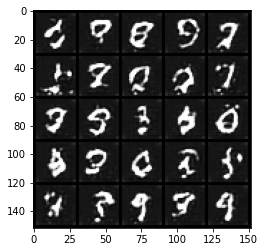

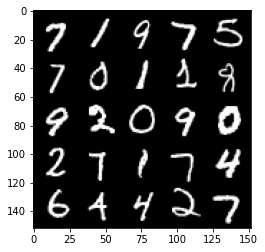

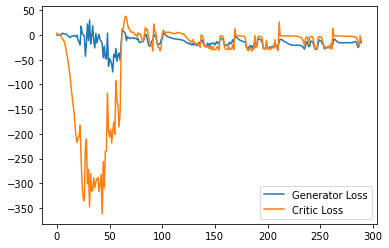

 47%|████▋     | 222/469 [01:05<01:45,  2.35it/s]

Step 5850: Generator loss: -20.31286009311676, critic loss: -20.5347998790741


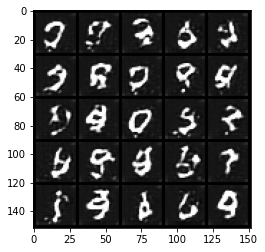

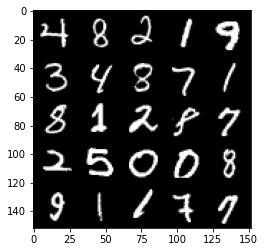

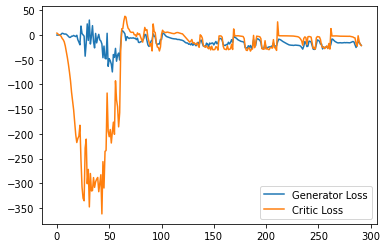

 58%|█████▊    | 272/469 [01:24<00:25,  7.69it/s]

Step 5900: Generator loss: -20.55709092617035, critic loss: -8.604382677555087


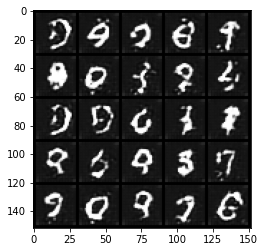

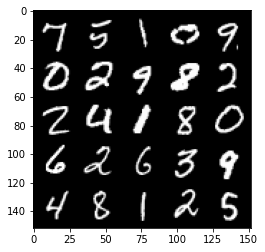

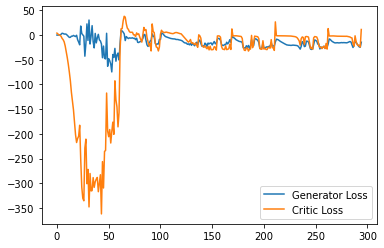

 69%|██████▊   | 322/469 [01:31<00:20,  7.16it/s]

Step 5950: Generator loss: -7.545901613235474, critic loss: -2.1491734676361083


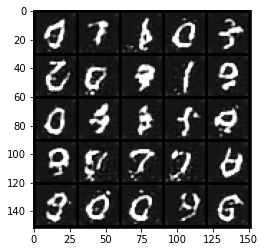

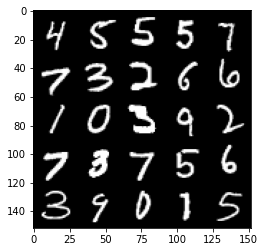

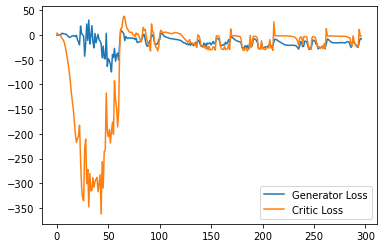

 79%|███████▉  | 372/469 [01:47<00:43,  2.26it/s]

Step 6000: Generator loss: -10.505311336517334, critic loss: -2.3861501955986015


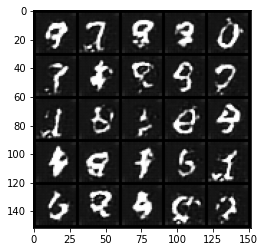

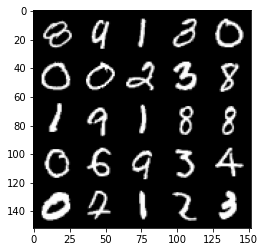

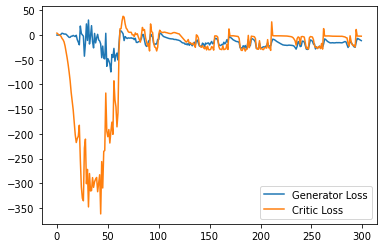

 90%|████████▉ | 422/469 [02:10<00:21,  2.22it/s]

Step 6050: Generator loss: -12.126157341003418, critic loss: -2.6677533788681025


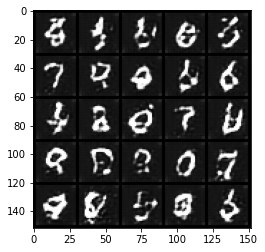

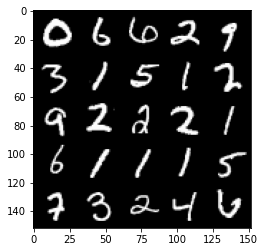

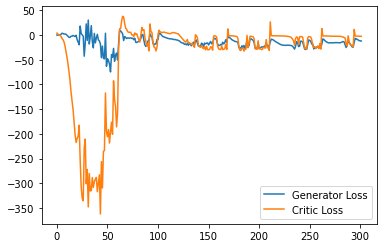

  1%|          | 3/469 [00:01<03:18,  2.34it/s]

Step 6100: Generator loss: -13.75888786315918, critic loss: -2.704350496768951


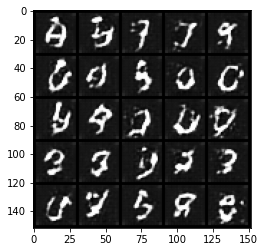

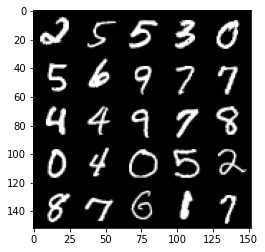

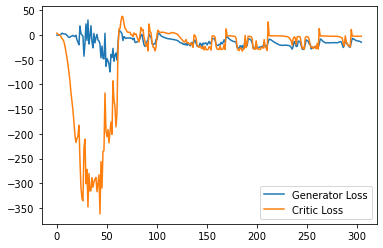

 11%|█▏        | 53/469 [00:22<03:01,  2.29it/s]

Step 6150: Generator loss: -16.9114129447937, critic loss: -2.3523476877212515


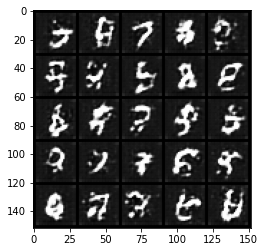

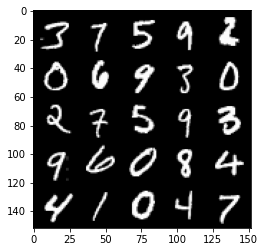

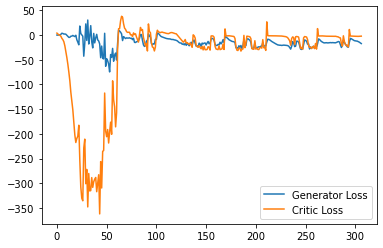

 22%|██▏       | 103/469 [00:35<00:54,  6.65it/s]

Step 6200: Generator loss: -17.92600624084473, critic loss: -3.1239033527374267


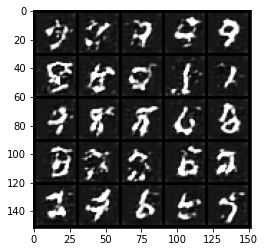

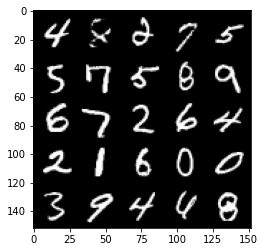

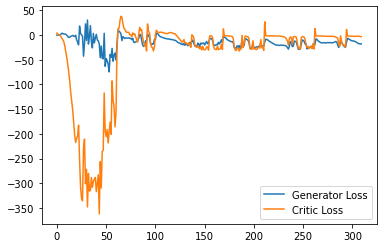

 33%|███▎      | 153/469 [00:43<00:48,  6.47it/s]

Step 6250: Generator loss: -21.415022087097167, critic loss: -9.058435450553894


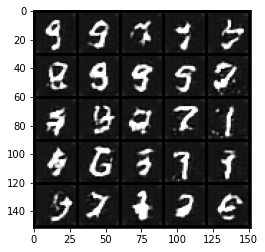

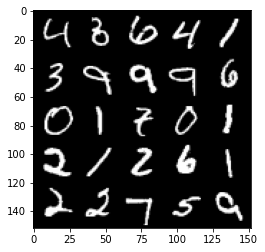

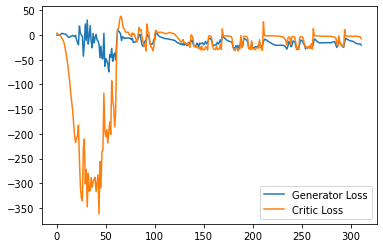

 43%|████▎     | 203/469 [00:58<01:59,  2.22it/s]

Step 6300: Generator loss: -14.826579475402832, critic loss: -0.22979770636558552


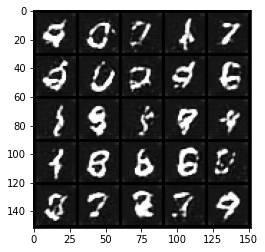

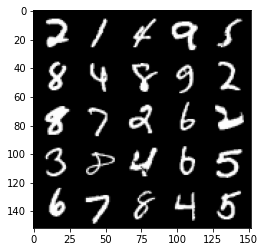

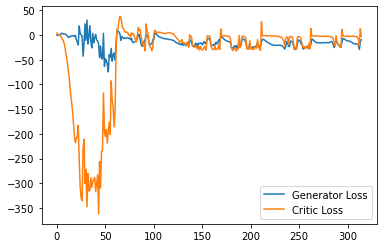

 54%|█████▍    | 253/469 [01:21<01:37,  2.21it/s]

Step 6350: Generator loss: -12.495706005096435, critic loss: -2.115074350833893


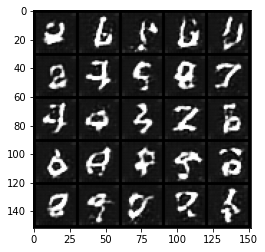

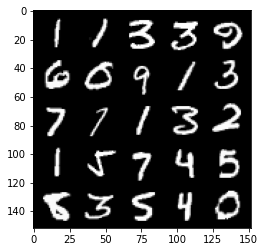

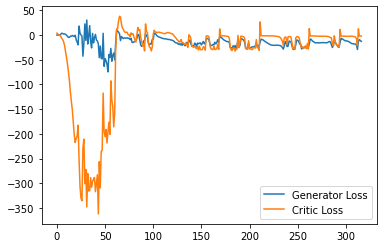

 65%|██████▍   | 303/469 [01:43<01:14,  2.22it/s]

Step 6400: Generator loss: -13.801036739349366, critic loss: -2.5094338212013234


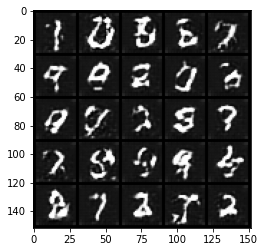

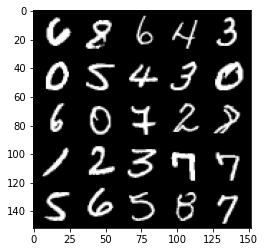

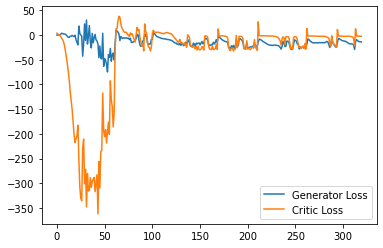

 75%|███████▌  | 353/469 [01:53<00:20,  5.55it/s]

Step 6450: Generator loss: -14.561887760162353, critic loss: -3.1645602340698242


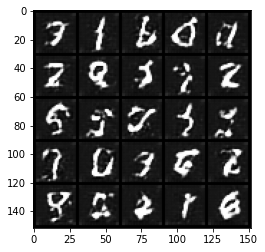

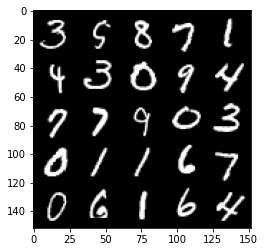

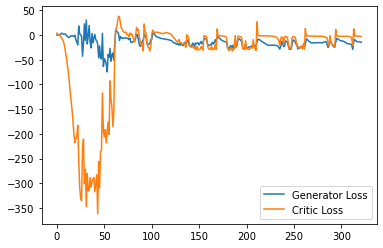

 86%|████████▌ | 403/469 [02:02<00:11,  5.62it/s]

Step 6500: Generator loss: -19.49681192398071, critic loss: -8.759360605239868


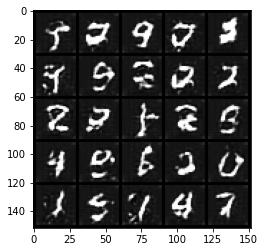

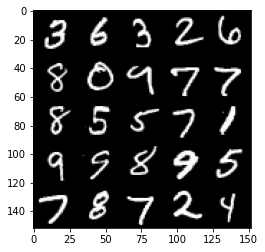

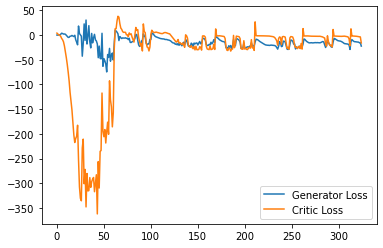

 97%|█████████▋| 453/469 [02:12<00:02,  5.60it/s]

Step 6550: Generator loss: -9.815047035217285, critic loss: 0.023587433815001963


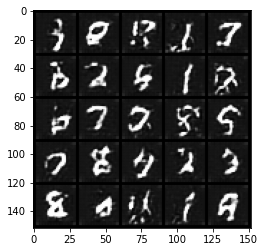

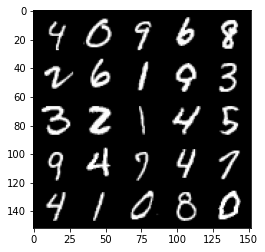

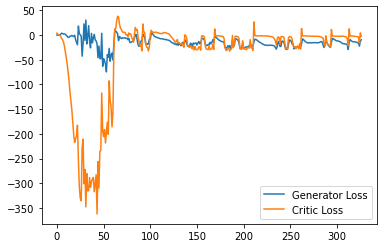

  7%|▋         | 34/469 [00:09<03:14,  2.23it/s]

Step 6600: Generator loss: -16.744648265838624, critic loss: -7.869657220363617


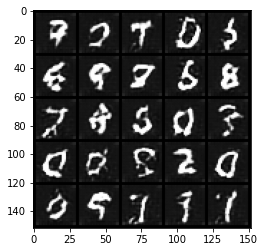

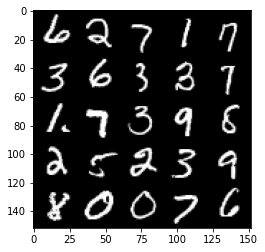

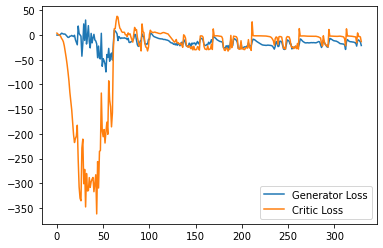

 18%|█▊        | 84/469 [00:32<02:53,  2.22it/s]

Step 6650: Generator loss: -25.26802615404129, critic loss: -24.489398886203766


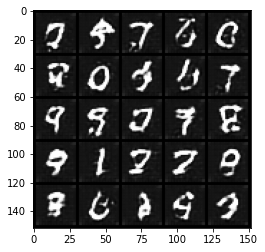

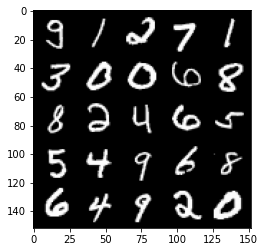

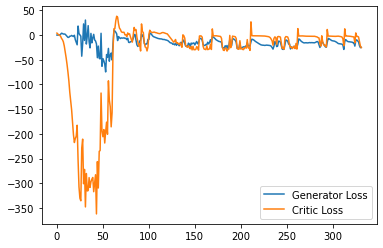

 29%|██▊       | 134/469 [00:55<02:31,  2.22it/s]

Step 6700: Generator loss: -21.34707271337509, critic loss: -22.518113127708435


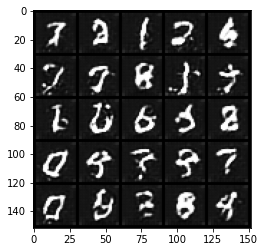

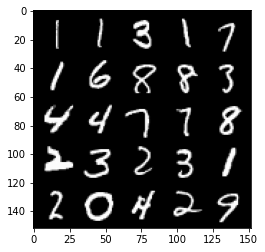

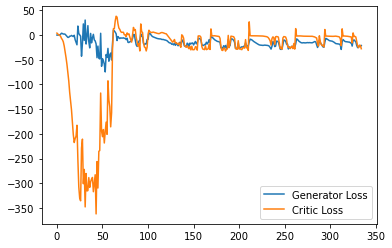

 39%|███▉      | 184/469 [01:18<02:08,  2.22it/s]

Step 6750: Generator loss: -11.194650182723999, critic loss: -4.334916496276857


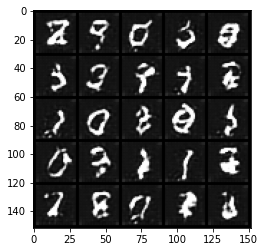

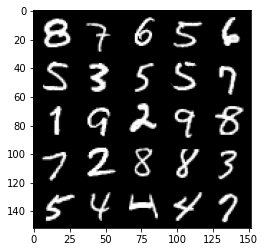

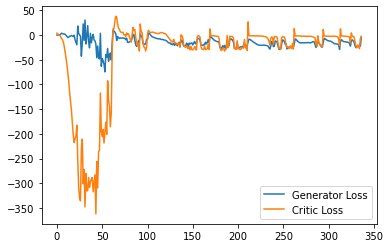

 50%|████▉     | 234/469 [01:36<00:37,  6.19it/s]

Step 6800: Generator loss: -8.041147241592407, critic loss: -3.0270246715545657


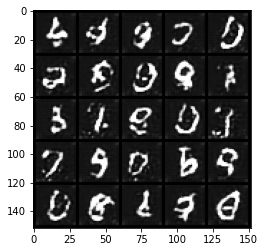

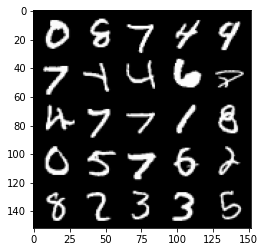

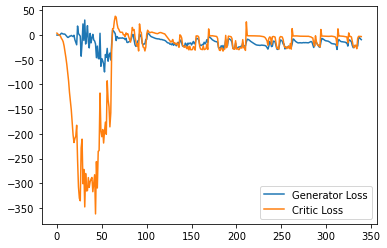

 61%|██████    | 284/469 [01:45<00:30,  6.03it/s]

Step 6850: Generator loss: -11.25403507232666, critic loss: -3.760122712135316


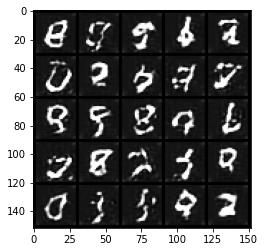

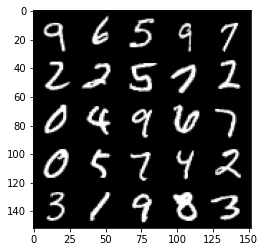

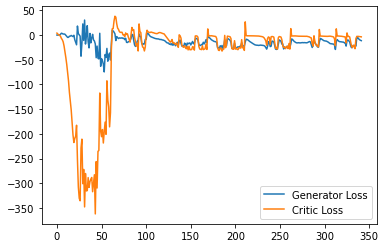

 71%|███████   | 334/469 [01:53<00:22,  6.06it/s]

Step 6900: Generator loss: -16.738444023132324, critic loss: -12.40572779750824


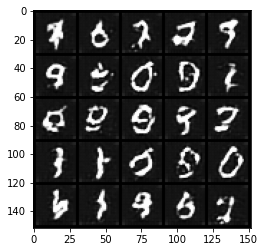

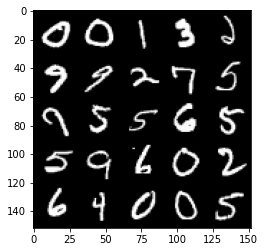

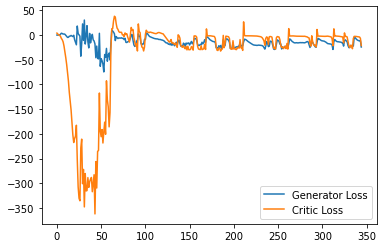

 82%|████████▏ | 384/469 [02:07<00:38,  2.22it/s]

Step 6950: Generator loss: -22.199284310340882, critic loss: -21.522517385959617


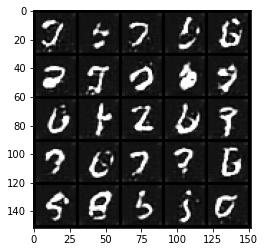

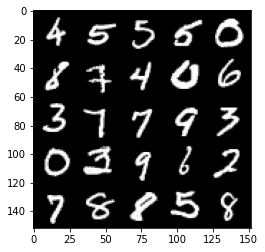

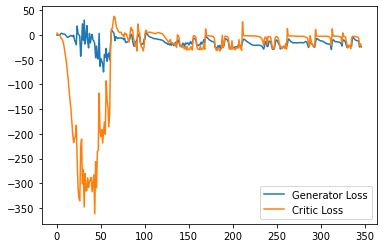

 93%|█████████▎| 434/469 [02:30<00:15,  2.22it/s]

Step 7000: Generator loss: -20.364007494449616, critic loss: -19.39566154670715


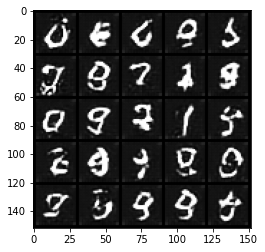

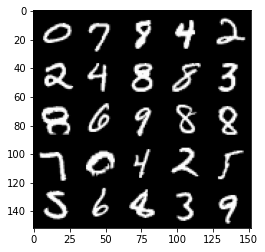

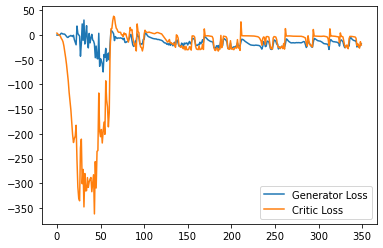

  3%|▎         | 15/469 [00:06<03:24,  2.22it/s]

Step 7050: Generator loss: -10.804951229095458, critic loss: -2.5369330253601086


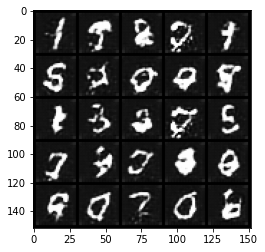

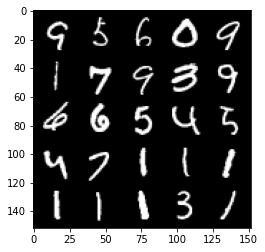

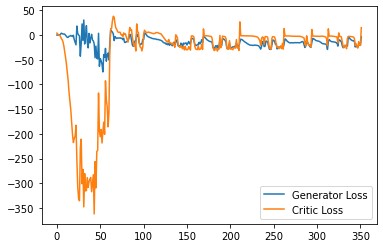

 14%|█▍        | 65/469 [00:26<01:11,  5.64it/s]

Step 7100: Generator loss: -10.787488050460816, critic loss: -3.2993838052749624


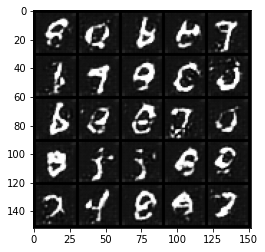

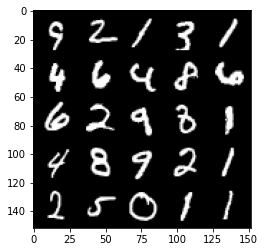

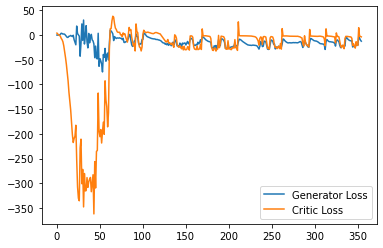

 25%|██▍       | 115/469 [00:35<00:59,  5.91it/s]

Step 7150: Generator loss: -23.071779279708863, critic loss: -16.88171316051483


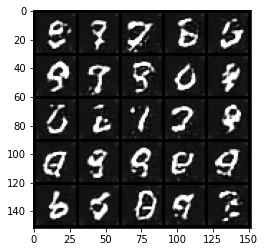

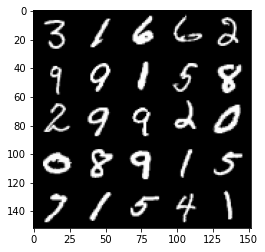

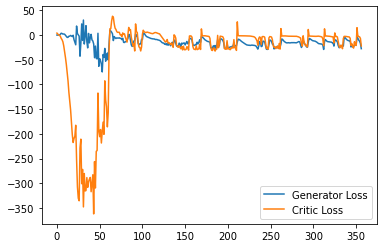

 35%|███▌      | 165/469 [00:44<00:53,  5.72it/s]

Step 7200: Generator loss: -13.439008131027222, critic loss: -6.938056482791894


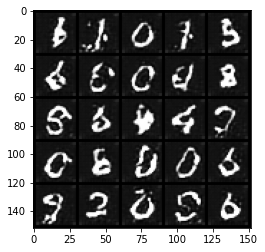

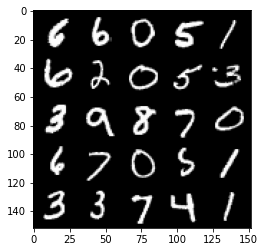

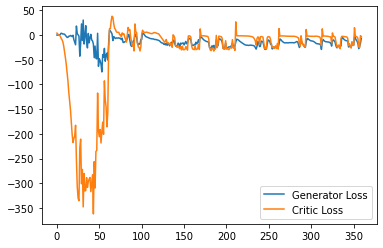

 46%|████▌     | 215/469 [00:53<00:44,  5.72it/s]

Step 7250: Generator loss: -8.960147132873535, critic loss: -3.644089971542359


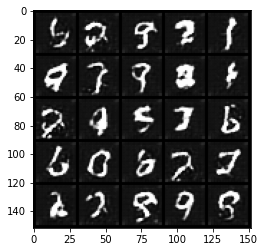

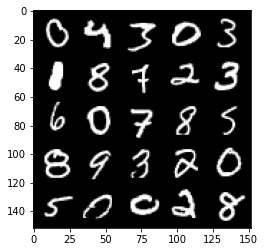

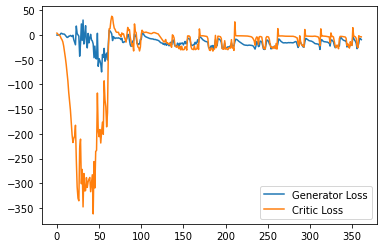

 57%|█████▋    | 265/469 [01:15<01:32,  2.21it/s]

Step 7300: Generator loss: -15.13308255791664, critic loss: -13.216975261688235


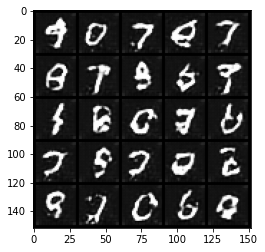

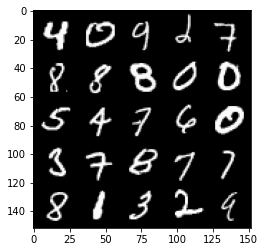

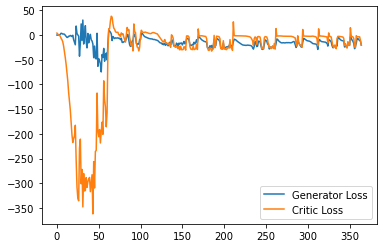

 67%|██████▋   | 315/469 [01:38<01:09,  2.21it/s]

Step 7350: Generator loss: -24.091992543935774, critic loss: -23.770824239730832


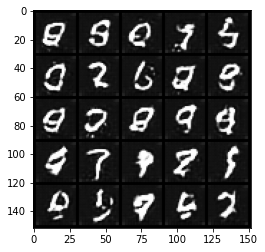

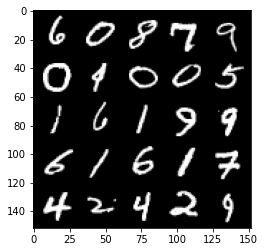

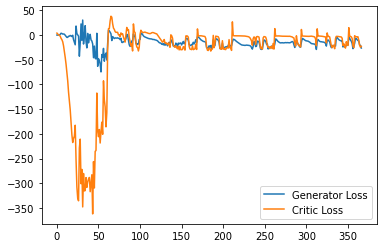

 78%|███████▊  | 365/469 [02:01<00:46,  2.22it/s]

Step 7400: Generator loss: -22.1078634929657, critic loss: -19.743932621955867


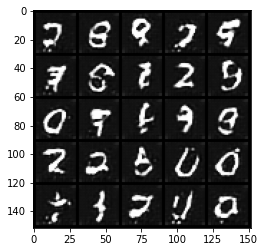

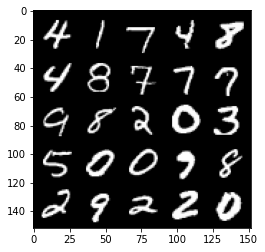

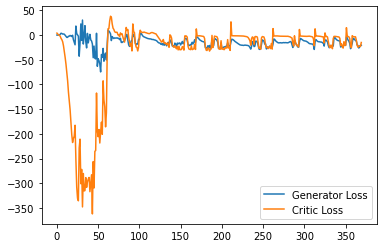

 88%|████████▊ | 415/469 [02:17<00:07,  6.78it/s]

Step 7450: Generator loss: -15.687988488674163, critic loss: -10.3801673913002


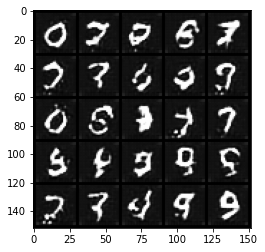

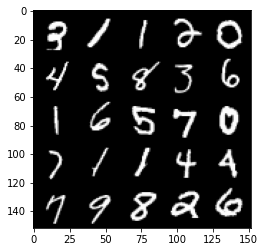

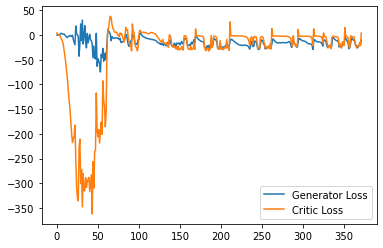

 99%|█████████▉| 465/469 [02:25<00:00,  6.71it/s]

Step 7500: Generator loss: -13.218535223007201, critic loss: -12.47736607933044


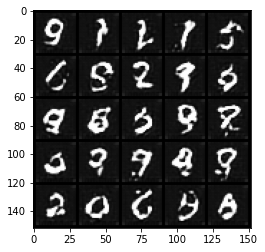

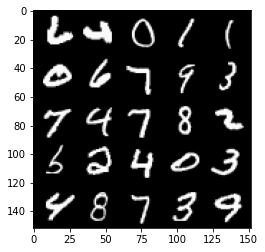

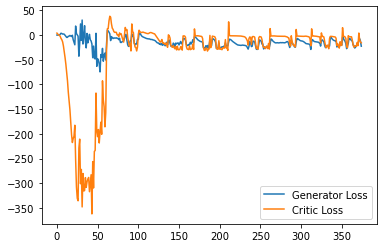

 10%|▉         | 46/469 [00:07<01:19,  5.30it/s]

Step 7550: Generator loss: -19.252671471834184, critic loss: -18.421866219520574


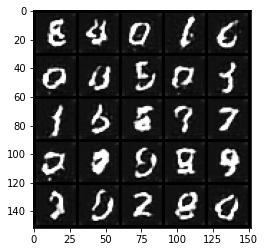

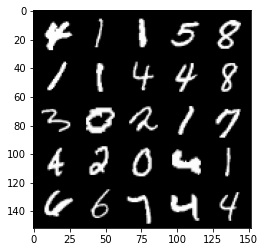

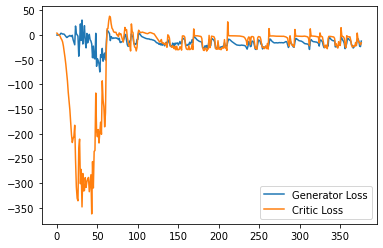

 20%|██        | 96/469 [00:17<01:10,  5.30it/s]

Step 7600: Generator loss: -15.631180989146232, critic loss: -18.289695343494415


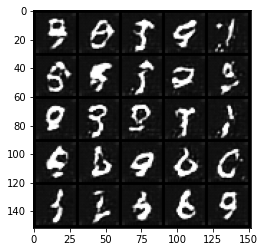

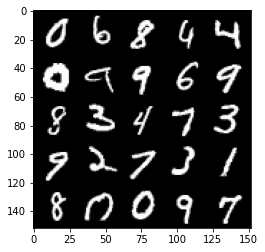

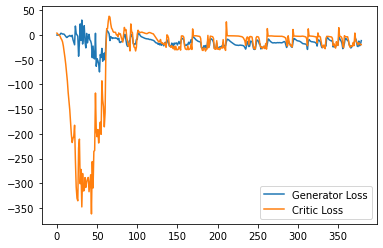

 31%|███       | 146/469 [00:31<02:23,  2.25it/s]

Step 7650: Generator loss: -18.9349915599823, critic loss: -20.540407904624935


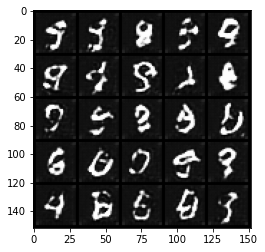

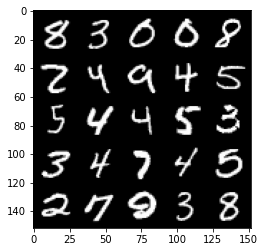

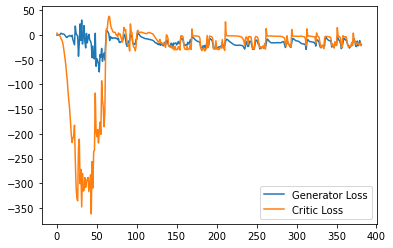

 42%|████▏     | 196/469 [00:53<02:02,  2.23it/s]

Step 7700: Generator loss: -11.722598797976971, critic loss: -4.489358899116517


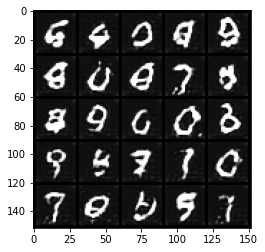

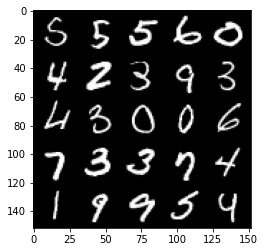

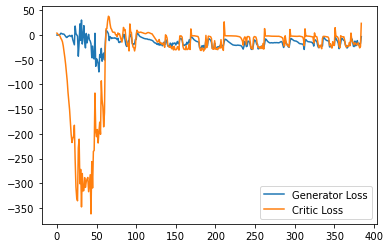

 52%|█████▏    | 246/469 [01:16<01:40,  2.22it/s]

Step 7750: Generator loss: -5.629711418151856, critic loss: -3.4082915825843805


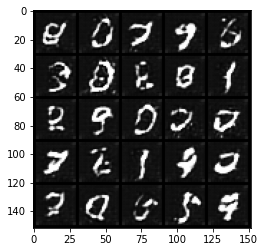

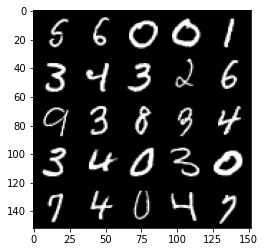

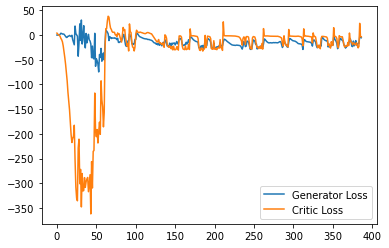

 63%|██████▎   | 296/469 [01:39<01:17,  2.23it/s]

Step 7800: Generator loss: -9.463336219787598, critic loss: -2.50815468454361


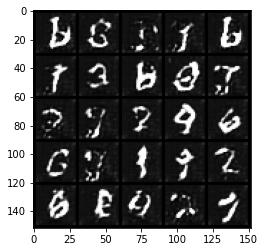

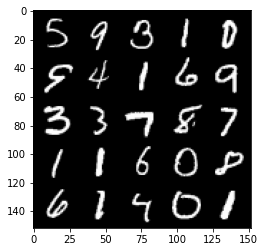

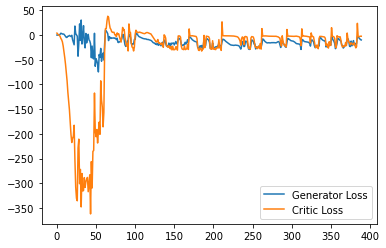

 74%|███████▍  | 346/469 [01:57<00:19,  6.17it/s]

Step 7850: Generator loss: -9.711222667694091, critic loss: -3.080551412582397


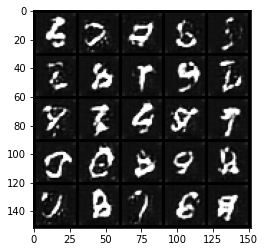

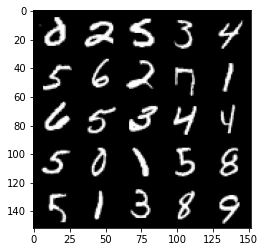

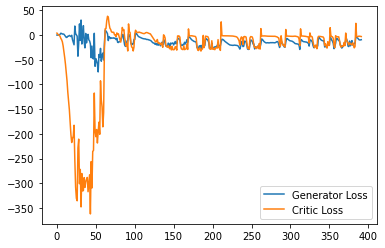

 84%|████████▍ | 396/469 [02:06<00:11,  6.16it/s]

Step 7900: Generator loss: -9.581030912399292, critic loss: -3.72078406238556


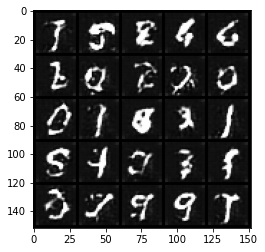

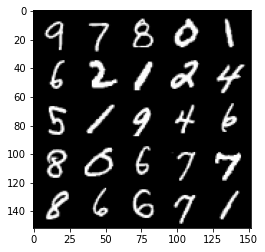

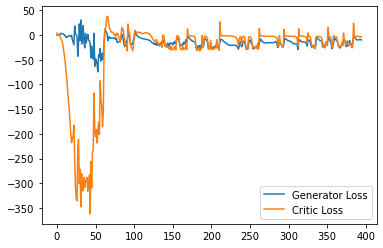

 95%|█████████▌| 446/469 [02:14<00:03,  6.12it/s]

Step 7950: Generator loss: -16.466196403503417, critic loss: -10.140944030761718


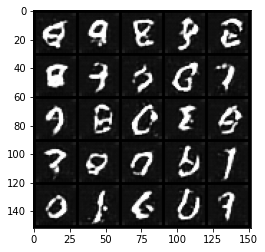

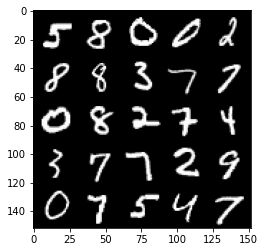

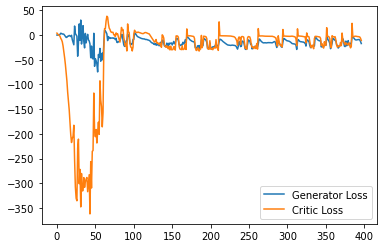

  6%|▌         | 27/469 [00:11<03:18,  2.23it/s]

Step 8000: Generator loss: -17.942652492523194, critic loss: -13.078256749629976


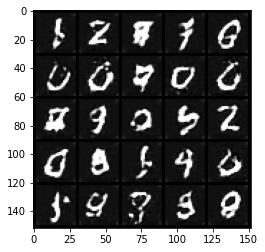

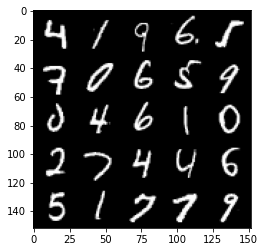

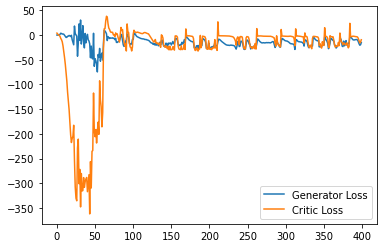

 13%|█▎        | 59/469 [00:26<03:01,  2.26it/s]

KeyboardInterrupt: 

In [166]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
